# INFO411 - Assignment 2

## Part 1: Exploratory Data Analysis

Import all the necessary packages and load the Training and Test data.

In [26]:
# import Pkg; Pkg.add("MLJ")
# import Pkg; Pkg.add("CSV")
# import Pkg; Pkg.add("DataFrames")
# import Pkg; Pkg.add("Tables")
# import Pkg; Pkg.add("CategoricalArrays")
# import Pkg; Pkg.add("Statistics")
# import Pkg; Pkg.add("StatsBase")
# import Pkg; Pkg.add("Plots")
# import Pkg; Pkg.add("StatsPlots")
# import Pkg; Pkg.add("LinearAlgebra")
using MLJ, CSV, DataFrames, Tables, CategoricalArrays, Statistics, StatsBase, Plots, StatsPlots, LinearAlgebra, Random
df_train = CSV.read("mitbih_train.csv", DataFrame, header=0)
df_test = CSV.read("mitbih_test.csv", DataFrame, header=0)
df = vcat(df_train,df_test)

,Column1,Column2,Column3,Column4,Column5,Column6,Column7,Column8
,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64
1,0.977941,0.926471,0.681373,0.245098,0.154412,0.191176,0.151961,0.0857843
2,0.960114,0.863248,0.461538,0.196581,0.0940171,0.125356,0.0997151,0.0883191
3,1.0,0.659459,0.186486,0.0702703,0.0702703,0.0594595,0.0567568,0.0432432
4,0.925414,0.665746,0.541436,0.276243,0.196133,0.0773481,0.0718232,0.0607735
5,0.967136,1.0,0.830986,0.586854,0.356808,0.248826,0.14554,0.0892019
6,0.927461,1.0,0.626943,0.193437,0.0949914,0.0725389,0.0431779,0.0535406
7,0.423611,0.791667,1.0,0.256944,0.0,0.277778,0.465278,0.520833
8,0.716814,0.539823,0.283186,0.129794,0.0648968,0.0766962,0.0265487,0.0324484
9,0.874214,0.849057,0.480084,0.0587002,0.0901468,0.310273,0.387841,0.385744


Extract the last column, which is the class, so we can use this later for labelling. 

In [12]:
class = df_train[:, end]

87554-element Vector{Float64}:
 0.0
 0.0
 0.0
 0.0
 0.0
 0.0
 0.0
 0.0
 0.0
 0.0
 ⋮
 4.0
 4.0
 4.0
 4.0
 4.0
 4.0
 4.0
 4.0
 4.0

Find the count of samples by class in the Training and Test data

In [13]:
sample_count_train = combine(groupby(df_train, [188]), nrow => :count)

,Column188,count
,Float64,Int64
1,0.0,72471
2,1.0,2223
3,2.0,5788
4,3.0,641
5,4.0,6431


In [14]:
sample_count_test = combine(groupby(df_test, [188]), nrow => :count)

,Column188,count
,Float64,Int64
1,0.0,18118
2,1.0,556
3,2.0,1448
4,3.0,162
5,4.0,1608


We can observe straight away that the training data is imbalanced, with the vast majority of the samples falling under Class 0. We can handle that later, but for now, let's explore the data first.

In [15]:
#extract all data by class
df_train_0 = df_train[df_train[:,188] .== 0.0, :]
df_train_1 = df_train[df_train[:,188] .== 1.0, :]
df_train_2 = df_train[df_train[:,188] .== 2.0, :]
df_train_3 = df_train[df_train[:,188] .== 3.0, :]
df_train_4 = df_train[df_train[:,188] .== 4.0, :]

,Column1,Column2,Column3,Column4,Column5,Column6,Column7,Column8
,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64
1,0.71261,0.629032,0.527859,0.414956,0.284457,0.164223,0.0806452,0.0322581
2,1.0,0.484848,0.541667,0.526515,0.522727,0.507576,0.496212,0.412879
3,0.584046,0.5,0.424501,0.324786,0.233618,0.128205,0.0498575,0.0
4,1.0,0.93617,0.878598,0.813517,0.727159,0.607009,0.496871,0.365457
5,0.680412,0.584192,0.491409,0.379725,0.269759,0.149485,0.0721649,0.0120275
6,0.679105,0.61194,0.503731,0.324627,0.19403,0.212687,0.16791,0.0820896
7,0.69783,0.577629,0.459098,0.322204,0.198664,0.118531,0.0567613,0.033389
8,0.943128,0.8594,0.823065,0.734597,0.666667,0.505529,0.369668,0.259084
9,0.930825,0.882282,0.813107,0.741505,0.637136,0.527913,0.379854,0.235437


We can plot the mean values of each class and visualise them in a line plot. 

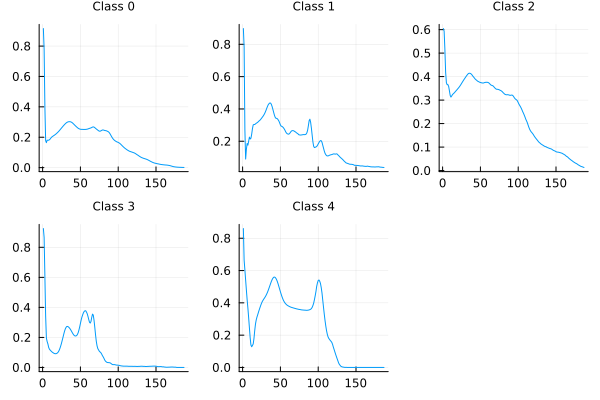

In [16]:
m_class_0 = Matrix(df_train_0)[:, 1:end-1]
m_class_1 = Matrix(df_train_1)[:, 1:end-1]
m_class_2 = Matrix(df_train_2)[:, 1:end-1]
m_class_3 = Matrix(df_train_3)[:, 1:end-1]
m_class_4 = Matrix(df_train_4)[:, 1:end-1]
avg_class_0 = mean(m_class_0, dims=1)
avg_class_1 = mean(m_class_1, dims=1)
avg_class_2 = mean(m_class_2, dims=1)
avg_class_3 = mean(m_class_3, dims=1)
avg_class_4 = mean(m_class_4, dims=1)
p1 = plot(1:187, vec(avg_class_0), label="", title="Class 0", titlefont = font(8))
p2 = plot(1:187, vec(avg_class_1), label="", title="Class 1", titlefont = font(8))
p3 = plot(1:187, vec(avg_class_2), label="", title="Class 2", titlefont = font(8))
p4 = plot(1:187, vec(avg_class_3), label="", title="Class 3", titlefont = font(8))
p5 = plot(1:187, vec(avg_class_4), label="", title="Class 4", titlefont = font(8))
plot(p1, p2, p3, p4, p5, layout=5)

We can also produce boxplots and histograms to see the distribution of data by class. 

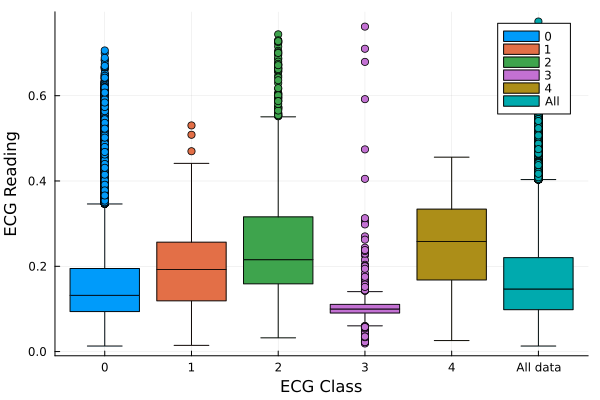

In [17]:
m_train = Matrix(df_train)
class_0_mean = mean(m_class_0, dims=2)
class_1_mean = mean(m_class_1, dims=2)
class_2_mean = mean(m_class_2, dims=2)
class_3_mean = mean(m_class_3, dims=2)
class_4_mean = mean(m_class_4, dims=2)
data_mean = mean(m_train, dims=2)
boxplot(class_0_mean, xlab="ECG Class", ylab="ECG Reading", label = "0", xticks = ([1:1:6;], ["0", "1", "2", "3", "4", "All data"]))
boxplot!(class_1_mean, label = "1")
boxplot!(class_2_mean, label = "2")
boxplot!(class_3_mean, label = "3")
boxplot!(class_4_mean, label = "4")
boxplot!(data_mean, label = "All")

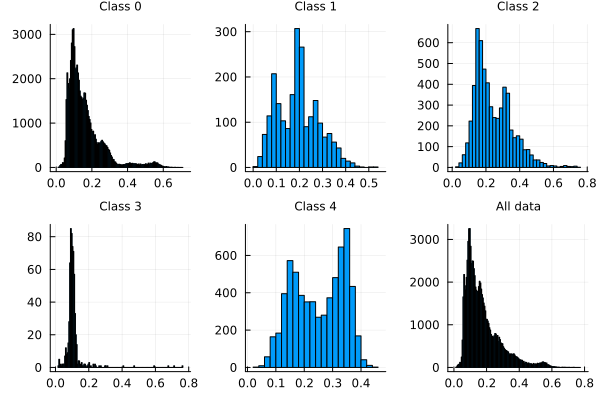

In [18]:
h1 = Plots.histogram(class_0_mean, title="Class 0", label="", titlefont = font(8))
h2 = Plots.histogram(class_1_mean, title="Class 1", label="", titlefont = font(8))
h3 = Plots.histogram(class_2_mean, title="Class 2", label="", titlefont = font(8))
h4 = Plots.histogram(class_3_mean, title="Class 3", label="", titlefont = font(8))
h5 = Plots.histogram(class_4_mean, title="Class 4", label="", titlefont = font(8))
h6 = Plots.histogram(data_mean, title="All data", label="", titlefont = font(8))
Plots.plot(h1, h2, h3, h4, h5, h6, layout=grid(2,3, heights=[0.5, 0.5, 0.5, 0.5]))

### PCA

In [19]:
data_train = Matrix(df_train)[:, 1:end-1]
X_train = data_train' 

187×87554 adjoint(::Matrix{Float64}) with eltype Float64:
 0.977941   0.960114   1.0        0.925414   …  0.906122  0.858228  0.901506
 0.926471   0.863248   0.659459   0.665746      0.62449   0.64557   0.845886
 0.681373   0.461538   0.186486   0.541436      0.595918  0.84557   0.800695
 0.245098   0.196581   0.0702703  0.276243      0.57551   0.248101  0.748552
 0.154412   0.0940171  0.0702703  0.196133      0.530612  0.167089  0.687138
 0.191176   0.125356   0.0594595  0.0773481  …  0.481633  0.131646  0.599073
 0.151961   0.0997151  0.0567568  0.0718232     0.444898  0.121519  0.512167
 0.0857843  0.0883191  0.0432432  0.0607735     0.387755  0.121519  0.427578
 0.0588235  0.0740741  0.0540541  0.0662983     0.322449  0.118987  0.395133
 0.0490196  0.0826211  0.0459459  0.0580111     0.191837  0.103797  0.402086
 ⋮                                           ⋱                      
 0.0        0.0        0.0        0.0           0.0       0.0       0.0
 0.0        0.0        0.0     

Calculate the mean vector and the covariance matrix of the standardized data 

In [20]:
m = mean(X_train, dims=2)   # get the mean vector
R = (X_train.- m)*(X_train .- m)'/size(X_train)[2]   # make the data zero-meaned, then get the covariance matrix

187×187 Matrix{Float64}:
  0.0580365     0.041601      0.00773554   …  -0.000268407  -0.000253469
  0.041601      0.0492006     0.0252864       -7.37412e-5   -7.07185e-5
  0.00773554    0.0252864     0.051667        -0.000247333  -0.00025209
 -0.00671763   -0.00111441    0.0316188       -0.00030867   -0.000309473
 -0.0104043    -0.00583092    0.0161856       -0.000113766  -0.000118212
 -0.0146078    -0.00628789    0.0135171    …   9.67802e-7   -7.32279e-6
 -0.0185188    -0.00928111    0.0114194        2.21718e-7   -6.98438e-6
 -0.0204976    -0.0112146     0.00831785       6.37092e-5    5.74687e-5
 -0.021597     -0.0122958     0.00540994       0.000115472   0.000111289
 -0.0227065    -0.0127456     0.00296589       7.13437e-5    6.84431e-5
  ⋮                                        ⋱   ⋮            
 -0.000548343  -0.000189256  -0.00018598       0.00100583    0.000958155
 -0.000448396  -0.00012469   -0.000197341      0.00100612    0.000955828
 -0.000382926  -8.22874e-5   -0.000197844  …

Get the eigenvalues and the corresponding eigenvectors to perform PCA, and reverse the order of the eigenvectors to get the values in decreasing order

In [21]:
eigvals(R)
evecs = eigvecs(R) 
reverse!(evecs, dims=2)

187×187 Matrix{Float64}:
  0.0957835   -0.0138804    0.0471594   …  -0.000232206  -1.14613e-5
  0.0559579   -0.0161852    0.0548077       0.00024059    4.50108e-5
 -0.0118173    0.00832249   0.0811526       4.06742e-5    8.9977e-5
 -0.0301901    0.0195587    0.0577312      -0.000228849  -0.000393946
 -0.0399418    0.00371327   0.0215738       0.00106571    0.000780697
 -0.0526892   -0.0113447   -0.00733041  …  -0.00237133   -0.000352008
 -0.063318    -0.0192583   -0.028645        0.00196026   -0.000108879
 -0.068135    -0.0213512   -0.0417519       0.000395524  -0.000207647
 -0.0711652   -0.0251942   -0.0520749      -0.00155673    0.00043974
 -0.0752419   -0.0335121   -0.0587736       0.000586514  -1.50808e-5
  ⋮                                     ⋱   ⋮            
 -0.00279882   0.011004    -0.0111091       0.00466312    0.000700885
 -0.00250496   0.0100573   -0.0101305       0.00642955    0.00216076
 -0.00226428   0.00923651  -0.00930004  …  -0.107898     -0.00809303
 -0.00203931   

Produce the 2-D projections of the PCA.

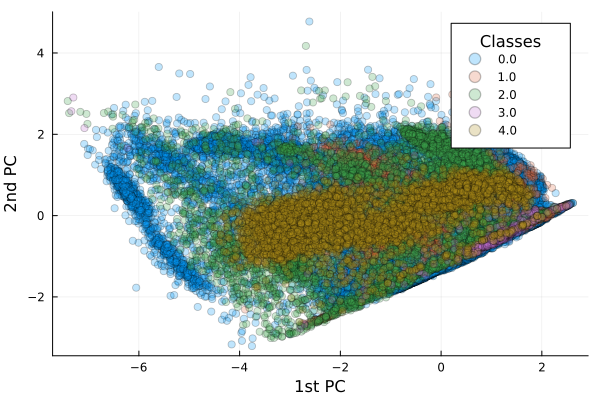

In [22]:
proj = evecs[:, 1:2]' * (X_train .- m)
Plots.scatter(proj[1,:], proj[2,:], group=class, legendtitle="Classes", legend=:topright, xlabel="1st PC", ylabel="2nd PC", alpha=0.25)

We can check the composition of the first and second eigenvector.

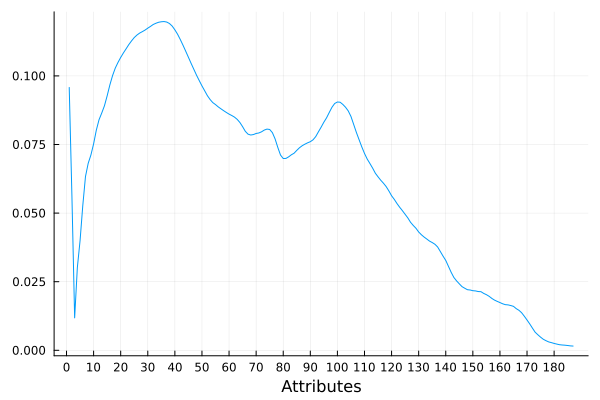

In [23]:
Plots.plot(1:187, abs.(evecs[:,1]), xlabel="Attributes", label="", xticks = 0:10:187)

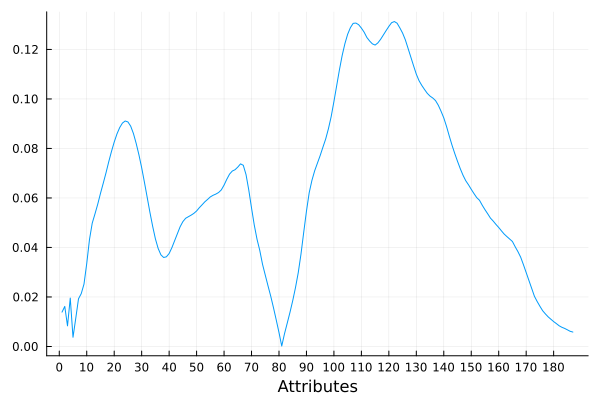

In [24]:
Plots.plot(1:187, abs.(evecs[:,2]), xlabel="Attributes", label="", legend=:topleft, xticks = 0:10:187)

## Part 2: Classification

Before we commence with the classification exercise, we'll need to address first the imbalance in training data. One way to overcome this is by oversampling, where we extract equal number of samples by class to balance the data.

In [27]:
#extract equal number of sample data by class and retrieve index
sample_train_0_index= sample(1:nrow(df_train_0), 10000)
sample_train_1_index = sample(1:nrow(df_train_1), 10000)
sample_train_2_index = sample(1:nrow(df_train_2), 10000)
sample_train_3_index = sample(1:nrow(df_train_3), 10000)
sample_train_4_index = sample(1:nrow(df_train_4), 10000)

#create downsampled dataframe by class 
df_sample_train_0 = df_train_0[sample_train_0_index,:]
df_sample_train_1 = df_train_1[sample_train_1_index,:]
df_sample_train_2 = df_train_2[sample_train_2_index,:]
df_sample_train_3 = df_train_3[sample_train_3_index,:]
df_sample_train_4 = df_train_4[sample_train_4_index,:]

#concatenate all downsampled classes into one dataframe
df_sample_train = vcat(df_sample_train_0, df_sample_train_1 ,df_sample_train_2, df_sample_train_3, df_sample_train_4)

#concatenate sample train and test data into one dataframe
df_sample = vcat(df_sample_train, df_test)

,Column1,Column2,Column3,Column4,Column5,Column6,Column7,Column8
,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64
1,0.975472,0.879245,0.584906,0.4,0.34717,0.369811,0.322642,0.286792
2,0.979943,0.747851,0.292264,0.0573066,0.0515759,0.0687679,0.0429799,0.0
3,0.994141,1.0,0.552734,0.269531,0.220703,0.220703,0.173828,0.162109
4,1.0,0.641834,0.0974212,0.0143266,0.0,0.0229226,0.0286533,0.0229226
5,1.0,0.665706,0.449568,0.227666,0.15562,0.0720461,0.0259366,0.0201729
6,1.0,0.570667,0.36,0.237333,0.165333,0.08,0.0373333,0.024
7,1.0,0.664694,0.201183,0.183432,0.147929,0.0552268,0.0631164,0.147929
8,0.0,0.0825,0.2575,0.42,0.48,0.5075,0.67,0.6725
9,0.938069,0.925319,0.442623,0.0510018,0.0382514,0.0710383,0.0673953,0.0728597


Training dataset is now balanced with equal number of samples per class.

In [26]:
sample_count_train = combine(groupby(df_sample_train, [188]), nrow => :count)

,Column188,count
,Float64,Int64
1,0.0,10000
2,1.0,10000
3,2.0,10000
4,3.0,10000
5,4.0,10000


We can specify the training rows and testing rows, which we'll be using for the classification. 

In [28]:
tr_inds = collect(1:50000)
te_inds = collect(50001:71892)

21892-element Vector{Int64}:
 50001
 50002
 50003
 50004
 50005
 50006
 50007
 50008
 50009
 50010
     ⋮
 71884
 71885
 71886
 71887
 71888
 71889
 71890
 71891
 71892

We can now unpack data. Below, we've specified to only include Columns 1 to 135 in the machine learning models we'll be running, based on the PCA performed earlier. This is to reduce the noise in the data and only use important features when running the classification models. 

(Note that we have also run the exact experiments below using ALL the columns/features, and have noted that the accuracy has improved in all the models after the features have been reduced. We have therefore decided to use the reduced set of features for the experiments below.)

In [29]:
df_final = select(df_sample, Between(:Column1,:Column135), :Column188)
y, X = unpack(df_final, ==(:Column188))
X1 = Tables.columntable(X)
y = categorical(y)

71892-element CategoricalArray{Float64,1,UInt32}:
 0.0
 0.0
 0.0
 0.0
 0.0
 0.0
 0.0
 0.0
 0.0
 0.0
 ⋮
 4.0
 4.0
 4.0
 4.0
 4.0
 4.0
 4.0
 4.0
 4.0

### KNN

In [29]:
# import Pkg; Pkg.add("NearestNeighborModels")
using NearestNeighborModels

Wrap parameters in a model and create a machine using the model and data

In [30]:
Random.seed!(1234);
knn = KNNClassifier(K=5)
mach_knn = machine(knn, X1, y)

untrained Machine; caches model-specific representations of data
  model: KNNClassifier(K = 5, …)
  args: 
    1:	Source @971 ⏎ Table{AbstractVector{Continuous}}
    2:	Source @065 ⏎ AbstractVector{Multiclass{5}}


Evaluate the performance of the model using a 10-fold cross-validation

In [31]:
eval_knn=evaluate!(mach_knn, rows=tr_inds, resampling=CV(nfolds=10,shuffle=true,rng=42), measure=accuracy,operation=predict_mode)

┌ Info: Creating subsamples from a subset of all rows. 
└ @ MLJBase C:\Users\carlo\.julia\packages\MLJBase\CtxrQ\src\resampling.jl:601


Evaluating over 10 folds:  20%[=====>                   ]  ETA: 0:01:44

Evaluating over 10 folds:  30%[=======>                 ]  ETA: 0:01:24

Evaluating over 10 folds:  40%[==========>              ]  ETA: 0:01:08

Evaluating over 10 folds:  50%[============>            ]  ETA: 0:00:55

Evaluating over 10 folds:  60%[===============>         ]  ETA: 0:00:44

Evaluating over 10 folds:  70%[=================>       ]  ETA: 0:00:33

Evaluating over 10 folds:  80%[====================>    ]  ETA: 0:00:22

Evaluating over 10 folds:  90%[======================>  ]  ETA: 0:00:11

Evaluating over 10 folds: 100%[=========================] Time: 0:01:50


PerformanceEvaluation object with these fields:
  measure, operation, measurement, per_fold,
  per_observation, fitted_params_per_fold,
  report_per_fold, train_test_rows
Extract:
┌────────────┬──────────────┬─────────────┬─────────┬───────────────────────────
│ measure    │ operation    │ measurement │ 1.96*SE │ per_fold                 ⋯
├────────────┼──────────────┼─────────────┼─────────┼───────────────────────────
│ Accuracy() │ predict_mode │ 0.964       │ 0.00216 │ [0.963, 0.966, 0.96, 0.9 ⋯
└────────────┴──────────────┴─────────────┴─────────┴───────────────────────────
                                                                1 column omitted


Use the trained model to predict the test data and measure the accuracy.

In [32]:
test_results=Dict(); # create a dict to collect all the test results from the various models
yhat = predict_mode(mach_knn, rows=te_inds)
test_results["acc_knn"] =accuracy(yhat, y[te_inds])

0.9007856751324685

Generate the confusion matrix

In [33]:
ConfusionMatrix()(yhat, y[te_inds])

┌ Warning: The classes are un-ordered,
│ using order: [0.0, 1.0, 2.0, 3.0, 4.0].
│ To suppress this warning, consider coercing to OrderedFactor.
└ @ MLJBase C:\Users\carlo\.julia\packages\MLJBase\CtxrQ\src\measures\confusion_matrix.jl:122


5×5 Matrix{Int64}:
 16216   59    31   10    30
  1143  475    27    1    12
   388   13  1344   15    16
   279    8    40  136     1
    92    1     6    0  1549

Plot out an accuracy run-chart for classifiers using different k's between 1 to 5.  

┌ Info: Training machine(KNNClassifier(K = 1, …), …).
└ @ MLJBase C:\Users\carlo\.julia\packages\MLJBase\CtxrQ\src\machines.jl:496
┌ Info: Training machine(KNNClassifier(K = 2, …), …).
└ @ MLJBase C:\Users\carlo\.julia\packages\MLJ

Base\CtxrQ\src\machines.jl:496
┌ Info: Training machine(KNNClassifier(K = 3, …), …).
└ @ MLJBase C:\Users\carlo\.julia\packages\MLJBase\CtxrQ\src\machines.jl:496


┌ Info: Training machine(KNNClassifier(K = 4, …), …).
└ @ MLJBase C:\Users\carlo\.julia\packages\MLJBase\CtxrQ\src\machines.jl:496


┌ Info: Training machine(KNNClassifier(K = 5, …), …).
└ @ MLJBase C:\Users\carlo\.julia\packages\MLJBase\CtxrQ\src\machines.jl:496


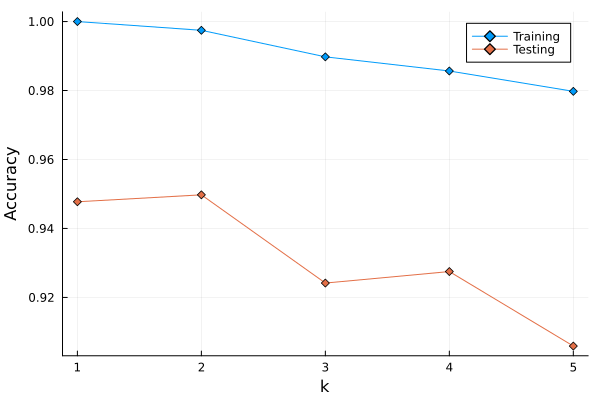

In [34]:
train=[]
test=[]
for i in 1:5
    knnc = KNNClassifier(K=i)
    knnc_mach = machine(knnc, X1, y) 
    MLJ.fit!(knnc_mach, rows=tr_inds)
    tr_acc = accuracy(MLJ.predict_mode(knnc_mach, rows=tr_inds), y[tr_inds])
    te_acc = accuracy(MLJ.predict_mode(knnc_mach, rows=te_inds), y[te_inds])
    push!(train, tr_acc)
    push!(test, te_acc)
end

plot(1:5,train,xlab="k",ylab="Accuracy", marker=:d, label="Training")
plot!(1:5,test,xlab="k",ylab="Accuracy", marker=:d, label="Testing")

Apply a distance-weighted voting scheme to the kNN model and re-run the model to check accuracy and confusion matrix.

In [35]:
knn = KNNClassifier(K=5, weights=Inverse())
mach_knn = machine(knn, X1, y)
eval_knn=evaluate!(mach_knn, rows=tr_inds, resampling=CV(nfolds=10,shuffle=true,rng=42), measure=accuracy,operation=predict_mode)
yhat = predict_mode(mach_knn, rows=te_inds)
test_results["acc_knn"] =accuracy(yhat, y[te_inds])

┌ Info: Creating subsamples from a subset of all rows. 
└ @ MLJBase C:\Users\carlo\.julia\packages\MLJBase\CtxrQ\src\resampling.jl:601
Evaluating over 10 folds:  20%[=====>                   ]  ETA: 0:01:26

Evaluating over 10 folds:  30%[=======>                 ]  ETA: 0:01:12

Evaluating over 10 folds:  40%[==========>              ]  ETA: 0:01:01

Evaluating over 10 folds:  50%[============>            ]  ETA: 0:00:50

Evaluating over 10 folds:  60%[===============>         ]  ETA: 0:00:40

Evaluating over 10 folds:  70%[=================>       ]  ETA: 0:00:30

Evaluating over 10 folds:  80%[====================>    ]  ETA: 0:00:20

Evaluating over 10 folds:  90%[======================>  ]  ETA: 0:00:10

Evaluating over 10 folds: 100%[=========================] Time: 0:01:41


0.9031609720445825

In [36]:
ConfusionMatrix()(yhat, y[te_inds])

┌ Warning: The classes are un-ordered,
│ using order: [0.0, 1.0, 2.0, 3.0, 4.0].
│ To suppress this warning, consider coercing to OrderedFactor.
└ @ MLJBase C:\Users\carlo\.julia\packages\MLJBase\CtxrQ\src\measures\confusion_matrix.jl:122


5×5 Matrix{Int64}:
 16264   59    29   10    28
  1095  475    28    1    11
   387   13  1345   15    16
   272    8    40  136     1
   100    1     6    0  1552

We can create the function below to fit the model and obtain the false-positive rates (fprs) and true-positive rates (tprs).

In [37]:
function fprs_tprs(model, X, y, train, test)
    mach = machine(model, X, y)
    MLJ.fit!(mach; rows=train)
    predictions = MLJ.predict(mach; rows=test)
    fprs, tprs, _ = roc_curve(predictions, y[test])
    return fprs, tprs
end;

fprs_tprs(knn, X1, y, tr_inds, te_inds)


┌ Info: Training machine(KNNClassifier(K = 5, …), …).
└ @ MLJBase C:\Users\carlo\.julia\packages\MLJBase\CtxrQ\src\machines.jl:496


([0.0, 0.01551368578927634, 0.01551368578927634, 0.01551368578927634, 0.015560554930633672, 0.015560554930633672, 0.015607424071991002, 0.015654293213348332, 0.015654293213348332, 0.015654293213348332  …  0.0880671166104237, 0.08811398575178103, 0.08816085489313835, 0.08820772403449569, 0.08825459317585302, 0.08830146231721035, 0.08834833145856767, 0.088395200599925, 0.08844206974128234, 1.0], [0.0, 0.7769784172661871, 0.7787769784172662, 0.7805755395683454, 0.7805755395683454, 0.7823741007194245, 0.7823741007194245, 0.7823741007194245, 0.7841726618705036, 0.7859712230215827  …  0.8848920863309353, 0.8848920863309353, 0.8848920863309353, 0.8848920863309353, 0.8848920863309353, 0.8848920863309353, 0.8848920863309353, 0.8848920863309353, 0.8848920863309353, 1.0])

### Decision Tree

Wrap parameters in a model and create a machine using the model and data.

In [38]:
Random.seed!(1234);
Tree = @load DecisionTreeClassifier pkg=DecisionTree
tree = Tree()
mach_tree = machine(tree, X1, y)

┌ Info: For silent loading, specify `verbosity=0`. 
└ @ Main C:\Users\carlo\.julia\packages\MLJModels\GlOTy\src\loading.jl:159


import MLJDecisionTreeInterface ✔


untrained Machine; caches model-specific representations of data
  model: DecisionTreeClassifier(max_depth = -1, …)
  args: 
    1:	Source @446 ⏎ Table{AbstractVector{Continuous}}
    2:	Source @776 ⏎ AbstractVector{Multiclass{5}}


Evaluate the model using a 10-fold cross validation.

In [39]:
eval_tree=evaluate!(mach_tree,rows=tr_inds, resampling=CV(nfolds=10,shuffle=true,rng=42), measures=accuracy,operation=predict_mode)

┌ Info: Creating subsamples from a subset of all rows. 
└ @ MLJBase C:\Users\carlo\.julia\packages\MLJBase\CtxrQ\src\resampling.jl:601
Evaluating over 10 folds:  20%[=====>                   ]  ETA: 0:01:09

Evaluating over 10 folds:  30%[=======>                 ]  ETA: 0:00:58

Evaluating over 10 folds:  40%[==========>              ]  ETA: 0:00:49

Evaluating over 10 folds:  50%[============>            ]  ETA: 0:00:40

Evaluating over 10 folds:  60%[===============>         ]  ETA: 0:00:32

Evaluating over 10 folds:  70%[=================>       ]  ETA: 0:00:24

Evaluating over 10 folds:  80%[====================>    ]  ETA: 0:00:16

Evaluating over 10 folds:  90%[======================>  ]  ETA: 0:00:08

Evaluating over 10 folds: 100%[=========================] Time: 0:01:19


PerformanceEvaluation object with these fields:
  measure, operation, measurement, per_fold,
  per_observation, fitted_params_per_fold,
  report_per_fold, train_test_rows
Extract:
┌────────────┬──────────────┬─────────────┬─────────┬───────────────────────────
│ measure    │ operation    │ measurement │ 1.96*SE │ per_fold                 ⋯
├────────────┼──────────────┼─────────────┼─────────┼───────────────────────────
│ Accuracy() │ predict_mode │ 0.976       │ 0.00119 │ [0.976, 0.976, 0.976, 0. ⋯
└────────────┴──────────────┴─────────────┴─────────┴───────────────────────────
                                                                1 column omitted


Use the trained model to predict the test data and measure the accuracy

In [40]:
yhat = predict_mode(mach_tree, rows=te_inds)
test_results["acc_tree"] = accuracy(yhat, y[te_inds])

0.8954412570802119

In [41]:
ConfusionMatrix()(yhat, y[te_inds]) # Generate the Confusion Matrix

┌ Warning: The classes are un-ordered,
│ using order: [0.0, 1.0, 2.0, 3.0, 4.0].
│ To suppress this warning, consider coercing to OrderedFactor.
└ @ MLJBase C:\Users\carlo\.julia\packages\MLJBase\CtxrQ\src\measures\confusion_matrix.jl:122


5×5 Matrix{Int64}:
 16231   99    76   21    40
   816  430    29    3    13
   596   19  1296   17    28
   236    4    26  120     1
   239    4    21    1  1526

In [42]:
report(mach_tree).print_tree() # Print the decision tree

Feature 97 < 0.08768 ?
├─ Feature 4 < 0.124 ?
    ├─ Feature 66 < 0.01615 ?
        ├─ Feature 13 < 0.3974 ?
            ├─ Feature 5 < 0.08979 ?
                ├─ 
                └─ 
            └─ Feature 3 < 0.1795 ?
                ├─ 3 : 36/36
                └─ 
        └─ Feature 36 < 0.4743 ?
            ├─ Feature 86 < 0.0009452 ?
                ├─ 
                └─ 
            └─ Feature 31 < 0.6096 ?
                ├─ 
                └─ 
    └─ Feature 8 < 0.2509 ?
        ├─ Feature 89 < 0.001075 ?
            ├─ Feature 59 < 0.1013 ?
                ├─ 
                └─ 
            └─ Feature 102 < 0.01012 ?
                ├─ 
                └─ 
        └─ Feature 10 < 0.7089 ?
            ├─ Feature 1 < 0.9421 ?
                ├─ 
                └─ 
            └─ Feature 5 < 0.632 ?
                ├─ 
                └─ 
└─ Feature 4 < 0.273 ?
    ├─ Feature 1 < 0.7738 ?
        ├─ Feature 44 < 0.3149 ?
            ├─ Feature 27 < 0.3485 ?
               

Plot out a run-chart for both training and testing accuracies, experimenting with max_depth ranged from 1 to 20

┌ Info: Training machine(DecisionTreeClassifier(max_depth = 1, …), …).
└ @ MLJBase C:\Users\carlo\.julia\packages\MLJBase\CtxrQ\src\machines.jl:496


┌ Info: Training machine(DecisionTreeClassifier(max_depth = 2, …), …).
└ @ MLJBase C:\Users\carlo\.julia\packages\MLJBase\CtxrQ\src\machines.jl:496


┌ Info: Training machine(DecisionTreeClassifier(max_depth = 3, …), …).
└ @ MLJBase C:\Users\carlo\.julia\packages\MLJBase\CtxrQ\src\machines.jl:496


┌ Info: Training machine(DecisionTreeClassifier(max_depth = 4, …), …).
└ @ MLJBase C:\Users\carlo\.julia\packages\MLJBase\CtxrQ\src\machines.jl:496
┌ Info: Training machine(DecisionTreeClassifier(max_depth = 5, …), …).
└ @ MLJBase C:\Users\carlo\.julia\packages\MLJBase\CtxrQ\src\machines.jl:496


┌ Info: Training machine(DecisionTreeClassifier(max_depth = 6, …), …).
└ @ MLJBase C:\Users\carlo\.julia\packages\MLJBase\CtxrQ\src\machines.jl:496


┌ Info: Training machine(DecisionTreeClassifier(max_depth = 7, …), …).
└ @ MLJBase C:\Users\carlo\.julia\packages\MLJBase\CtxrQ\src\machines.jl:496


┌ Info: Training machine(DecisionTreeClassifier(max_depth = 8, …), …).
└ @ MLJBase C:\Users\carlo\.julia\packages\MLJBase\CtxrQ\src\machines.jl:496


┌ Info: Training machine(DecisionTreeClassifier(max_depth = 9, …), …).
└ @ MLJBase C:\Users\carlo\.julia\packages\MLJBase\CtxrQ\src\machines.jl:496


┌ Info: Training machine(DecisionTreeClassifier(max_depth = 10, …), …).
└ @ MLJBase C:\Users\carlo\.julia\packages\MLJBase\CtxrQ\src\machines.jl:496


┌ Info: Training machine(DecisionTreeClassifier(max_depth = 11, …), …).
└ @ MLJBase C:\Users\carlo\.julia\packages\MLJBase\CtxrQ\src\machines.jl:496


┌ Info: Training machine(DecisionTreeClassifier(max_depth = 12, …), …).
└ @ MLJBase C:\Users\carlo\.julia\packages\MLJBase\CtxrQ\src\machines.jl:496


┌ Info: Training machine(DecisionTreeClassifier(max_depth = 13, …), …).
└ @ MLJBase C:\Users\carlo\.julia\packages\MLJBase\CtxrQ\src\machines.jl:496


┌ Info: Training machine(DecisionTreeClassifier(max_depth = 14, …), …).
└ @ MLJBase C:\Users\carlo\.julia\packages\MLJBase\CtxrQ\src\machines.jl:496


┌ Info: Training machine(DecisionTreeClassifier(max_depth = 15, …), …).
└ @ MLJBase C:\Users\carlo\.julia\packages\MLJBase\CtxrQ\src\machines.jl:496


┌ Info: Training machine(DecisionTreeClassifier(max_depth = 16, …), …).
└ @ MLJBase C:\Users\carlo\.julia\packages\MLJBase\CtxrQ\src\machines.jl:496


┌ Info: Training machine(DecisionTreeClassifier(max_depth = 17, …), …).
└ @ MLJBase C:\Users\carlo\.julia\packages\MLJBase\CtxrQ\src\machines.jl:496


┌ Info: Training machine(DecisionTreeClassifier(max_depth = 18, …), …).
└ @ MLJBase C:\Users\carlo\.julia\packages\MLJBase\CtxrQ\src\machines.jl:496


┌ Info: Training machine(DecisionTreeClassifier(max_depth = 19, …), …).
└ @ MLJBase C:\Users\carlo\.julia\packages\MLJBase\CtxrQ\src\machines.jl:496


┌ Info: Training machine(DecisionTreeClassifier(max_depth = 20, …), …).
└ @ MLJBase C:\Users\carlo\.julia\packages\MLJBase\CtxrQ\src\machines.jl:496


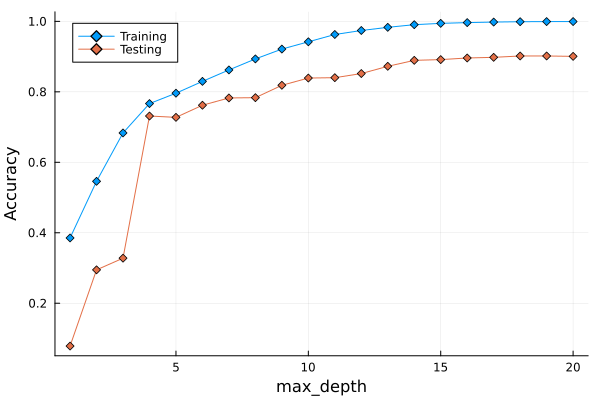

In [43]:
using Plots
train=[]
test=[]
for i in 1:20
    tree = Tree(max_depth=i)
    mach_tree = machine(tree, X1, y)
    MLJ.fit!(mach_tree, rows=tr_inds)
    tr_acc = accuracy(MLJ.predict_mode(mach_tree, rows=tr_inds), y[tr_inds])
    te_acc = accuracy(MLJ.predict_mode(mach_tree, rows=te_inds), y[te_inds])
    push!(train, tr_acc)
    push!(test, te_acc)
end

plot(1:20,train,xlab="max_depth",ylab="Accuracy", marker=:d, label="Training", legend=:topleft)
plot!(1:20,test,xlab="max_depth",ylab="Accuracy", marker=:d, label="Testing")

This time, we'll experiment with number of sub-features using the best max depth from above. 

┌ Info: Training machine(DecisionTreeClassifier(max_depth = 20, …), …).
└ @ MLJBase C:\Users\carlo\.julia\packages\MLJBase\CtxrQ\src\machines.jl:496
┌ Info: Training machine(DecisionTreeClassifier(max_depth = 20, …), …).
└ @ MLJBase C:\Users\carlo\.julia\packages\MLJBase\CtxrQ\src\machines.jl:496


┌ Info: Training machine(DecisionTreeClassifier(max_depth = 20, …), …).
└ @ MLJBase C:\Users\carlo\.julia\packages\MLJBase\CtxrQ\src\machines.jl:496


┌ Info: Training machine(DecisionTreeClassifier(max_depth = 20, …), …).
└ @ MLJBase C:\Users\carlo\.julia\packages\MLJBase\CtxrQ\src\machines.jl:496


┌ Info: Training machine(DecisionTreeClassifier(max_depth = 20, …), …).
└ @ MLJBase C:\Users\carlo\.julia\packages\MLJBase\CtxrQ\src\machines.jl:496


┌ Info: Training machine(DecisionTreeClassifier(max_depth = 20, …), …).
└ @ MLJBase C:\Users\carlo\.julia\packages\MLJBase\CtxrQ\src\machines.jl:496


┌ Info: Training machine(DecisionTreeClassifier(max_depth = 20, …), …).
└ @ MLJBase C:\Users\carlo\.julia\packages\MLJBase\CtxrQ\src\machines.jl:496


┌ Info: Training machine(DecisionTreeClassifier(max_depth = 20, …), …).
└ @ MLJBase C:\Users\carlo\.julia\packages\MLJBase\CtxrQ\src\machines.jl:496


┌ Info: Training machine(DecisionTreeClassifier(max_depth = 20, …), …).
└ @ MLJBase C:\Users\carlo\.julia\packages\MLJBase\CtxrQ\src\machines.jl:496


┌ Info: Training machine(DecisionTreeClassifier(max_depth = 20, …), …).
└ @ MLJBase C:\Users\carlo\.julia\packages\MLJBase\CtxrQ\src\machines.jl:496


┌ Info: Training machine(DecisionTreeClassifier(max_depth = 20, …), …).
└ @ MLJBase C:\Users\carlo\.julia\packages\MLJBase\CtxrQ\src\machines.jl:496


┌ Info: Training machine(DecisionTreeClassifier(max_depth = 20, …), …).
└ @ MLJBase C:\Users\carlo\.julia\packages\MLJBase\CtxrQ\src\machines.jl:496


┌ Info: Training machine(DecisionTreeClassifier(max_depth = 20, …), …).
└ @ MLJBase C:\Users\carlo\.julia\packages\MLJBase\CtxrQ\src\machines.jl:496


┌ Info: Training machine(DecisionTreeClassifier(max_depth = 20, …), …).
└ @ MLJBase C:\Users\carlo\.julia\packages\MLJBase\CtxrQ\src\machines.jl:496


┌ Info: Training machine(DecisionTreeClassifier(max_depth = 20, …), …).
└ @ MLJBase C:\Users\carlo\.julia\packages\MLJBase\CtxrQ\src\machines.jl:496
┌ Info: Training machine(DecisionTreeClassifier(max_depth = 20, …), …).
└ @ MLJBase C:\Users\carlo\.julia\packages\MLJBase\CtxrQ\src\machines.jl:496


┌ Info: Training machine(DecisionTreeClassifier(max_depth = 20, …), …).
└ @ MLJBase C:\Users\carlo\.julia\packages\MLJBase\CtxrQ\src\machines.jl:496


┌ Info: Training machine(DecisionTreeClassifier(max_depth = 20, …), …).
└ @ MLJBase C:\Users\carlo\.julia\packages\MLJBase\CtxrQ\src\machines.jl:496


┌ Info: Training machine(DecisionTreeClassifier(max_depth = 20, …), …).
└ @ MLJBase C:\Users\carlo\.julia\packages\MLJBase\CtxrQ\src\machines.jl:496


┌ Info: Training machine(DecisionTreeClassifier(max_depth = 20, …), …).
└ @ MLJBase C:\Users\carlo\.julia\packages\MLJBase\CtxrQ\src\machines.jl:496


┌ Info: Training machine(DecisionTreeClassifier(max_depth = 20, …), …).
└ @ MLJBase C:\Users\carlo\.julia\packages\MLJBase\CtxrQ\src\machines.jl:496


┌ Info: Training machine(DecisionTreeClassifier(max_depth = 20, …), …).
└ @ MLJBase C:\Users\carlo\.julia\packages\MLJBase\CtxrQ\src\machines.jl:496


┌ Info: Training machine(DecisionTreeClassifier(max_depth = 20, …), …).
└ @ MLJBase C:\Users\carlo\.julia\packages\MLJBase\CtxrQ\src\machines.jl:496


┌ Info: Training machine(DecisionTreeClassifier(max_depth = 20, …), …).
└ @ MLJBase C:\Users\carlo\.julia\packages\MLJBase\CtxrQ\src\machines.jl:496


┌ Info: Training machine(DecisionTreeClassifier(max_depth = 20, …), …).
└ @ MLJBase C:\Users\carlo\.julia\packages\MLJBase\CtxrQ\src\machines.jl:496


┌ Info: Training machine(DecisionTreeClassifier(max_depth = 20, …), …).
└ @ MLJBase C:\Users\carlo\.julia\packages\MLJBase\CtxrQ\src\machines.jl:496


┌ Info: Training machine(DecisionTreeClassifier(max_depth = 20, …), …).
└ @ MLJBase C:\Users\carlo\.julia\packages\MLJBase\CtxrQ\src\machines.jl:496


┌ Info: Training machine(DecisionTreeClassifier(max_depth = 20, …), …).
└ @ MLJBase C:\Users\carlo\.julia\packages\MLJBase\CtxrQ\src\machines.jl:496


┌ Info: Training machine(DecisionTreeClassifier(max_depth = 20, …), …).
└ @ MLJBase C:\Users\carlo\.julia\packages\MLJBase\CtxrQ\src\machines.jl:496


┌ Info: Training machine(DecisionTreeClassifier(max_depth = 20, …), …).
└ @ MLJBase C:\Users\carlo\.julia\packages\MLJBase\CtxrQ\src\machines.jl:496


┌ Info: Training machine(DecisionTreeClassifier(max_depth = 20, …), …).
└ @ MLJBase C:\Users\carlo\.julia\packages\MLJBase\CtxrQ\src\machines.jl:496


┌ Info: Training machine(DecisionTreeClassifier(max_depth = 20, …), …).
└ @ MLJBase C:\Users\carlo\.julia\packages\MLJBase\CtxrQ\src\machines.jl:496


┌ Info: Training machine(DecisionTreeClassifier(max_depth = 20, …), …).
└ @ MLJBase C:\Users\carlo\.julia\packages\MLJBase\CtxrQ\src\machines.jl:496


┌ Info: Training machine(DecisionTreeClassifier(max_depth = 20, …), …).
└ @ MLJBase C:\Users\carlo\.julia\packages\MLJBase\CtxrQ\src\machines.jl:496


┌ Info: Training machine(DecisionTreeClassifier(max_depth = 20, …), …).
└ @ MLJBase C:\Users\carlo\.julia\packages\MLJBase\CtxrQ\src\machines.jl:496


┌ Info: Training machine(DecisionTreeClassifier(max_depth = 20, …), …).
└ @ MLJBase C:\Users\carlo\.julia\packages\MLJBase\CtxrQ\src\machines.jl:496


┌ Info: Training machine(DecisionTreeClassifier(max_depth = 20, …), …).
└ @ MLJBase C:\Users\carlo\.julia\packages\MLJBase\CtxrQ\src\machines.jl:496


┌ Info: Training machine(DecisionTreeClassifier(max_depth = 20, …), …).
└ @ MLJBase C:\Users\carlo\.julia\packages\MLJBase\CtxrQ\src\machines.jl:496


┌ Info: Training machine(DecisionTreeClassifier(max_depth = 20, …), …).
└ @ MLJBase C:\Users\carlo\.julia\packages\MLJBase\CtxrQ\src\machines.jl:496


┌ Info: Training machine(DecisionTreeClassifier(max_depth = 20, …), …).
└ @ MLJBase C:\Users\carlo\.julia\packages\MLJBase\CtxrQ\src\machines.jl:496


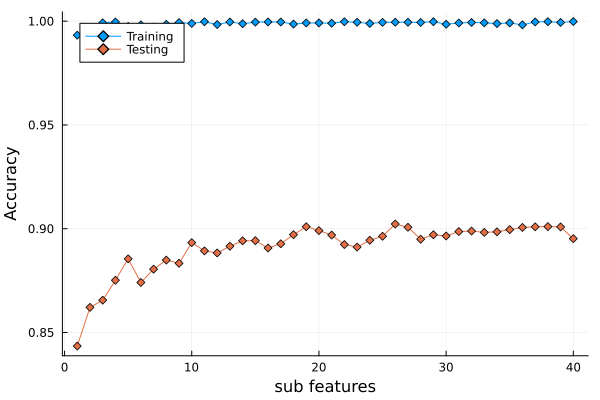

In [44]:
train=[]
test=[]
for i in 1:40
    tree = Tree(max_depth = 20, n_subfeatures=i)
    mach_tree = machine(tree, X1, y)
    MLJ.fit!(mach_tree, rows=tr_inds)
    tr_acc = accuracy(MLJ.predict_mode(mach_tree, rows=tr_inds), y[tr_inds])
    te_acc = accuracy(MLJ.predict_mode(mach_tree, rows=te_inds), y[te_inds])
    push!(train, tr_acc)
    push!(test, te_acc)
end

plot(1:40,train,xlab="sub features",ylab="Accuracy", marker=:d, label="Training", legend=:topleft)
plot!(1:40,test,xlab="sub features",ylab="Accuracy", marker=:d, label="Testing")

Rerun the model to use the best max_depth and n_subfeatures from above to see if we get a better accuracy

In [45]:
Random.seed!(1234);
tree.max_depth = 20
tree.n_subfeatures = 26
mach_tree = machine(tree, X1, y)
eval_tree=evaluate!(mach_tree,rows=tr_inds, resampling=CV(nfolds=10,shuffle=true,rng=42), measures=accuracy,operation=predict_mode)

┌ Info: Creating subsamples from a subset of all rows. 
└ @ MLJBase C:\Users\carlo\.julia\packages\MLJBase\CtxrQ\src\resampling.jl:601
Evaluating over 10 folds:  20%[=====>                   ]  ETA: 0:00:18

Evaluating over 10 folds:  30%[=======>                 ]  ETA: 0:00:16

Evaluating over 10 folds:  40%[==========>              ]  ETA: 0:00:14

Evaluating over 10 folds:  50%[============>            ]  ETA: 0:00:11

Evaluating over 10 folds:  60%[===============>         ]  ETA: 0:00:09

Evaluating over 10 folds:  70%[=================>       ]  ETA: 0:00:07

Evaluating over 10 folds:  80%[====================>    ]  ETA: 0:00:05

Evaluating over 10 folds:  90%[======================>  ]  ETA: 0:00:02

Evaluating over 10 folds: 100%[=========================] Time: 0:00:22


PerformanceEvaluation object with these fields:
  measure, operation, measurement, per_fold,
  per_observation, fitted_params_per_fold,
  report_per_fold, train_test_rows
Extract:
┌────────────┬──────────────┬─────────────┬─────────┬───────────────────────────
│ measure    │ operation    │ measurement │ 1.96*SE │ per_fold                 ⋯
├────────────┼──────────────┼─────────────┼─────────┼───────────────────────────
│ Accuracy() │ predict_mode │ 0.973       │ 0.00171 │ [0.973, 0.97, 0.971, 0.9 ⋯
└────────────┴──────────────┴─────────────┴─────────┴───────────────────────────
                                                                1 column omitted


In [46]:
yhat = predict_mode(mach_tree, rows=te_inds)
test_results["acc_tree"] = accuracy(yhat, y[te_inds])

0.891558560204641

In [47]:
ConfusionMatrix()(yhat, y[te_inds]) # Generate the Confusion Matrix

┌ Warning: The classes are un-ordered,
│ using order: [0.0, 1.0, 2.0, 3.0, 4.0].
│ To suppress this warning, consider coercing to OrderedFactor.
└ @ MLJBase C:\Users\carlo\.julia\packages\MLJBase\CtxrQ\src\measures\confusion_matrix.jl:122


5×5 Matrix{Int64}:
 16127  111    70   20    33
   818  421    19    3    12
   625   13  1313   21    22
   260    5    21  117     1
   288    6    25    1  1540

The tuning of parameters did not really improve the accuracy by that much. 

### SVM

In [48]:
# import Pkg; Pkg.add("MLJLIBSVMInterface")
# import Pkg; Pkg.add("LIBSVM")

Wrap parameters in a model and create a machine using the model and data.

In [49]:
Random.seed!(1234);
SVC = @load SVC pkg=LIBSVM
using LIBSVM
svc_model = SVC(kernel=LIBSVM.Kernel.Polynomial)

import MLJLIBSVMInterface ✔


┌ Info: For silent loading, specify `verbosity=0`. 
└ @ Main C:\Users\carlo\.julia\packages\MLJModels\GlOTy\src\loading.jl:159


SVC(
  kernel = LIBSVM.Kernel.Polynomial, 
  gamma = 0.0, 
  cost = 1.0, 
  cachesize = 200.0, 
  degree = 3, 
  coef0 = 0.0, 
  tolerance = 0.001, 
  shrinking = true, 
  probability = false)

Evaluate the performance using a 10-fold cross validation.

In [50]:
mach_svm = machine(svc_model, X1, y)
eval_svm=evaluate!(mach_svm,rows=tr_inds, resampling=CV(nfolds=10,shuffle=true,rng=42), measure=accuracy)

┌ Info: Creating subsamples from a subset of all rows. 
└ @ MLJBase C:\Users\carlo\.julia\packages\MLJBase\CtxrQ\src\resampling.jl:601


Evaluating over 10 folds:  20%[=====>                   ]  ETA: 0:22:41

Evaluating over 10 folds:  30%[=======>                 ]  ETA: 0:19:56

Evaluating over 10 folds:  40%[==========>              ]  ETA: 0:17:07

Evaluating over 10 folds:  50%[============>            ]  ETA: 0:14:12

Evaluating over 10 folds:  60%[===============>         ]  ETA: 0:11:16

Evaluating over 10 folds:  70%[=================>       ]  ETA: 0:08:24

Evaluating over 10 folds:  80%[====================>    ]  ETA: 0:05:34

Evaluating over 10 folds:  90%[======================>  ]  ETA: 0:02:46

Evaluating over 10 folds: 100%[=========================] Time: 0:27:33


PerformanceEvaluation object with these fields:
  measure, operation, measurement, per_fold,
  per_observation, fitted_params_per_fold,
  report_per_fold, train_test_rows
Extract:
┌────────────┬───────────┬─────────────┬─────────┬──────────────────────────────
│ measure    │ operation │ measurement │ 1.96*SE │ per_fold                    ⋯
├────────────┼───────────┼─────────────┼─────────┼──────────────────────────────
│ Accuracy() │ predict   │ 0.926       │ 0.00324 │ [0.926, 0.928, 0.926, 0.928 ⋯
└────────────┴───────────┴─────────────┴─────────┴──────────────────────────────
                                                                1 column omitted


Use the trained model to predict the test data and measure the accuracy.

In [51]:
yhat = MLJ.predict(mach_svm, rows=te_inds)
test_results["acc_svm"] = accuracy(yhat, y[te_inds])

0.88735611182167

In [52]:
ConfusionMatrix()(yhat, y[te_inds])

┌ Warning: The classes are un-ordered,
│ using order: [0.0, 1.0, 2.0, 3.0, 4.0].
│ To suppress this warning, consider coercing to OrderedFactor.
└ @ MLJBase C:\Users\carlo\.julia\packages\MLJBase\CtxrQ\src\measures\confusion_matrix.jl:122


5×5 Matrix{Int64}:
 15970   81    40    5    35
   913  454    27    6    15
   345    8  1312    5    11
   719   11    69  146     3
   171    2     0    0  1544

Generate a run chart (accuracy vs. degree) with the polynomial kernel degree varying from 1 to 10

┌ Info: Training machine(SVC(kernel = Polynomial, …), …).
└ @ MLJBase C:\Users\carlo\.julia\packages\MLJBase\CtxrQ\src\machines.jl:496


┌ Info: Training machine(SVC(kernel = Polynomial, …), …).
└ @ MLJBase C:\Users\carlo\.julia\packages\MLJBase\CtxrQ\src\machines.jl:496
┌ Info: Training machine(SVC(kernel = Polynomial, …), …).
└ @ MLJBase C:\Users\carlo\.julia\packages\MLJBase\CtxrQ\src\machines.jl:496


┌ Info: Training machine(SVC(kernel = Polynomial, …), …).
└ @ MLJBase C:\Users\carlo\.julia\packages\MLJBase\CtxrQ\src\machines.jl:496


┌ Info: Training machine(SVC(kernel = Polynomial, …), …).
└ @ MLJBase C:\Users\carlo\.julia\packages\MLJBase\CtxrQ\src\machines.jl:496


┌ Info: Training machine(SVC(kernel = Polynomial, …), …).
└ @ MLJBase C:\Users\carlo\.julia\packages\MLJBase\CtxrQ\src\machines.jl:496


┌ Info: Training machine(SVC(kernel = Polynomial, …), …).
└ @ MLJBase C:\Users\carlo\.julia\packages\MLJBase\CtxrQ\src\machines.jl:496


┌ Info: Training machine(SVC(kernel = Polynomial, …), …).
└ @ MLJBase C:\Users\carlo\.julia\packages\MLJBase\CtxrQ\src\machines.jl:496


┌ Info: Training machine(SVC(kernel = Polynomial, …), …).
└ @ MLJBase C:\Users\carlo\.julia\packages\MLJBase\CtxrQ\src\machines.jl:496


┌ Info: Training machine(SVC(kernel = Polynomial, …), …).
└ @ MLJBase C:\Users\carlo\.julia\packages\MLJBase\CtxrQ\src\machines.jl:496


┌ Info: Training machine(SVC(kernel = Polynomial, …), …).
└ @ MLJBase C:\Users\carlo\.julia\packages\MLJBase\CtxrQ\src\machines.jl:496


┌ Info: Training machine(SVC(kernel = Polynomial, …), …).
└ @ MLJBase C:\Users\carlo\.julia\packages\MLJBase\CtxrQ\src\machines.jl:496


┌ Info: Training machine(SVC(kernel = Polynomial, …), …).
└ @ MLJBase C:\Users\carlo\.julia\packages\MLJBase\CtxrQ\src\machines.jl:496


┌ Info: Training machine(SVC(kernel = Polynomial, …), …).
└ @ MLJBase C:\Users\carlo\.julia\packages\MLJBase\CtxrQ\src\machines.jl:496


┌ Info: Training machine(SVC(kernel = Polynomial, …), …).
└ @ MLJBase C:\Users\carlo\.julia\packages\MLJBase\CtxrQ\src\machines.jl:496


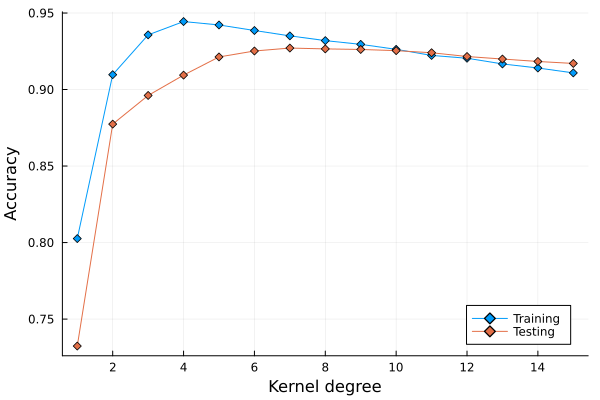

In [74]:
train=[]
test=[]
for i in 1:15
    svcmodel = SVC(kernel=LIBSVM.Kernel.Polynomial, degree=Int32(i));
    svcmach = machine(svcmodel, X1, y)
    MLJ.fit!(svcmach, rows=tr_inds)
    tr_acc = accuracy(MLJ.predict(svcmach, rows=tr_inds), y[tr_inds])
    te_acc = accuracy(MLJ.predict(svcmach, rows=te_inds), y[te_inds])
    push!(train, tr_acc)
    push!(test, te_acc)
end

plot(1:15, train, xlab="Kernel degree", ylab="Accuracy", marker=:d, label="Training", legend=:bottomright)
plot!(1:15, test, xlab="Kernel degree", ylab="Accuracy", marker=:d, label="Testing")

We'll use the best kernel degree from above, and this time we'll add a cost function to the model to see if it improves accuracy. 

┌ Info: Training machine(SVC(kernel = Polynomial, …), …).
└ @ MLJBase C:\Users\carlo\.julia\packages\MLJBase\CtxrQ\src\machines.jl:496


┌ Info: Training machine(SVC(kernel = Polynomial, …), …).
└ @ MLJBase C:\Users\carlo\.julia\packages\MLJBase\CtxrQ\src\machines.jl:496


┌ Info: Training machine(SVC(kernel = Polynomial, …), …).
└ @ MLJBase C:\Users\carlo\.julia\packages\MLJBase\CtxrQ\src\machines.jl:496


┌ Info: Training machine(SVC(kernel = Polynomial, …), …).
└ @ MLJBase C:\Users\carlo\.julia\packages\MLJBase\CtxrQ\src\machines.jl:496


┌ Info: Training machine(SVC(kernel = Polynomial, …), …).
└ @ MLJBase C:\Users\carlo\.julia\packages\MLJBase\CtxrQ\src\machines.jl:496


┌ Info: Training machine(SVC(kernel = Polynomial, …), …).
└ @ MLJBase C:\Users\carlo\.julia\packages\MLJBase\CtxrQ\src\machines.jl:496


┌ Info: Training machine(SVC(kernel = Polynomial, …), …).
└ @ MLJBase C:\Users\carlo\.julia\packages\MLJBase\CtxrQ\src\machines.jl:496


┌ Info: Training machine(SVC(kernel = Polynomial, …), …).
└ @ MLJBase C:\Users\carlo\.julia\packages\MLJBase\CtxrQ\src\machines.jl:496


┌ Info: Training machine(SVC(kernel = Polynomial, …), …).
└ @ MLJBase C:\Users\carlo\.julia\packages\MLJBase\CtxrQ\src\machines.jl:496


┌ Info: Training machine(SVC(kernel = Polynomial, …), …).
└ @ MLJBase C:\Users\carlo\.julia\packages\MLJBase\CtxrQ\src\machines.jl:496


┌ Info: Training machine(SVC(kernel = Polynomial, …), …).
└ @ MLJBase C:\Users\carlo\.julia\packages\MLJBase\CtxrQ\src\machines.jl:496


┌ Info: Training machine(SVC(kernel = Polynomial, …), …).
└ @ MLJBase C:\Users\carlo\.julia\packages\MLJBase\CtxrQ\src\machines.jl:496


┌ Info: Training machine(SVC(kernel = Polynomial, …), …).
└ @ MLJBase C:\Users\carlo\.julia\packages\MLJBase\CtxrQ\src\machines.jl:496


┌ Info: Training machine(SVC(kernel = Polynomial, …), …).
└ @ MLJBase C:\Users\carlo\.julia\packages\MLJBase\CtxrQ\src\machines.jl:496


┌ Info: Training machine(SVC(kernel = Polynomial, …), …).
└ @ MLJBase C:\Users\carlo\.julia\packages\MLJBase\CtxrQ\src\machines.jl:496


┌ Info: Training machine(SVC(kernel = Polynomial, …), …).
└ @ MLJBase C:\Users\carlo\.julia\packages\MLJBase\CtxrQ\src\machines.jl:496


┌ Info: Training machine(SVC(kernel = Polynomial, …), …).
└ @ MLJBase C:\Users\carlo\.julia\packages\MLJBase\CtxrQ\src\machines.jl:496


┌ Info: Training machine(SVC(kernel = Polynomial, …), …).
└ @ MLJBase C:\Users\carlo\.julia\packages\MLJBase\CtxrQ\src\machines.jl:496


┌ Info: Training machine(SVC(kernel = Polynomial, …), …).
└ @ MLJBase C:\Users\carlo\.julia\packages\MLJBase\CtxrQ\src\machines.jl:496


┌ Info: Training machine(SVC(kernel = Polynomial, …), …).
└ @ MLJBase C:\Users\carlo\.julia\packages\MLJBase\CtxrQ\src\machines.jl:496


┌ Info: Training machine(SVC(kernel = Polynomial, …), …).
└ @ MLJBase C:\Users\carlo\.julia\packages\MLJBase\CtxrQ\src\machines.jl:496


┌ Info: Training machine(SVC(kernel = Polynomial, …), …).
└ @ MLJBase C:\Users\carlo\.julia\packages\MLJBase\CtxrQ\src\machines.jl:496
┌ Info: Training machine(SVC(kernel = Polynomial, …), …).
└ @ MLJBase C:\Users\carlo\.julia\packages\MLJBase\CtxrQ\src\machines.jl:496


┌ Info: Training machine(SVC(kernel = Polynomial, …), …).
└ @ MLJBase C:\Users\carlo\.julia\packages\MLJBase\CtxrQ\src\machines.jl:496


┌ Info: Training machine(SVC(kernel = Polynomial, …), …).
└ @ MLJBase C:\Users\carlo\.julia\packages\MLJBase\CtxrQ\src\machines.jl:496


┌ Info: Training machine(SVC(kernel = Polynomial, …), …).
└ @ MLJBase C:\Users\carlo\.julia\packages\MLJBase\CtxrQ\src\machines.jl:496


┌ Info: Training machine(SVC(kernel = Polynomial, …), …).
└ @ MLJBase C:\Users\carlo\.julia\packages\MLJBase\CtxrQ\src\machines.jl:496


┌ Info: Training machine(SVC(kernel = Polynomial, …), …).
└ @ MLJBase C:\Users\carlo\.julia\packages\MLJBase\CtxrQ\src\machines.jl:496


┌ Info: Training machine(SVC(kernel = Polynomial, …), …).
└ @ MLJBase C:\Users\carlo\.julia\packages\MLJBase\CtxrQ\src\machines.jl:496


┌ Info: Training machine(SVC(kernel = Polynomial, …), …).
└ @ MLJBase C:\Users\carlo\.julia\packages\MLJBase\CtxrQ\src\machines.jl:496


┌ Info: Training machine(SVC(kernel = Polynomial, …), …).
└ @ MLJBase C:\Users\carlo\.julia\packages\MLJBase\CtxrQ\src\machines.jl:496


┌ Info: Training machine(SVC(kernel = Polynomial, …), …).
└ @ MLJBase C:\Users\carlo\.julia\packages\MLJBase\CtxrQ\src\machines.jl:496


┌ Info: Training machine(SVC(kernel = Polynomial, …), …).
└ @ MLJBase C:\Users\carlo\.julia\packages\MLJBase\CtxrQ\src\machines.jl:496


┌ Info: Training machine(SVC(kernel = Polynomial, …), …).
└ @ MLJBase C:\Users\carlo\.julia\packages\MLJBase\CtxrQ\src\machines.jl:496


┌ Info: Training machine(SVC(kernel = Polynomial, …), …).
└ @ MLJBase C:\Users\carlo\.julia\packages\MLJBase\CtxrQ\src\machines.jl:496


┌ Info: Training machine(SVC(kernel = Polynomial, …), …).
└ @ MLJBase C:\Users\carlo\.julia\packages\MLJBase\CtxrQ\src\machines.jl:496


┌ Info: Training machine(SVC(kernel = Polynomial, …), …).
└ @ MLJBase C:\Users\carlo\.julia\packages\MLJBase\CtxrQ\src\machines.jl:496


┌ Info: Training machine(SVC(kernel = Polynomial, …), …).
└ @ MLJBase C:\Users\carlo\.julia\packages\MLJBase\CtxrQ\src\machines.jl:496


┌ Info: Training machine(SVC(kernel = Polynomial, …), …).
└ @ MLJBase C:\Users\carlo\.julia\packages\MLJBase\CtxrQ\src\machines.jl:496


┌ Info: Training machine(SVC(kernel = Polynomial, …), …).
└ @ MLJBase C:\Users\carlo\.julia\packages\MLJBase\CtxrQ\src\machines.jl:496


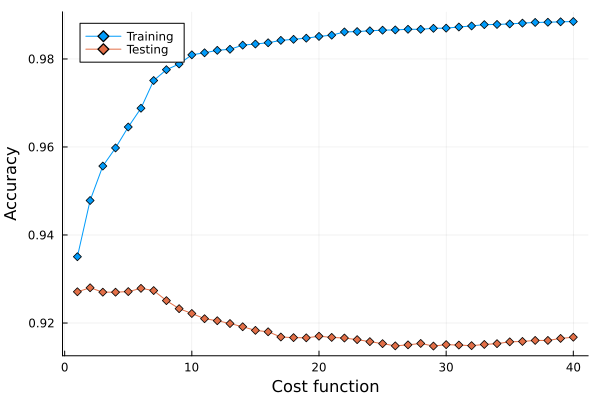

In [75]:
train=[]
test=[]
for i in 1:20
    svcmodel = SVC(kernel=LIBSVM.Kernel.Polynomial, degree=Int32(7), cost=Float64(i));
    svcmach = machine(svcmodel, X1, y)
    MLJ.fit!(svcmach, rows=tr_inds)
    tr_acc = accuracy(MLJ.predict(svcmach, rows=tr_inds), y[tr_inds])
    te_acc = accuracy(MLJ.predict(svcmach, rows=te_inds), y[te_inds])
    push!(train, tr_acc)
    push!(test, te_acc)
end

plot(1:20,train,xlab="Cost function",ylab="Accuracy", marker=:d, label="Training", legend=:topleft)
plot!(1:20,test,xlab="Cost function",ylab="Accuracy", marker=:d, label="Testing")

Re-run the model to use the best kernel degree and cost function.

In [39]:
svc_model = SVC(kernel=LIBSVM.Kernel.Polynomial, degree=Int32(7), cost=Float64(6));
mach_svm = machine(svc_model, X1, y)
eval_svm=evaluate!(mach_svm,rows=tr_inds, resampling=CV(nfolds=10,shuffle=true,rng=42), measure=accuracy)

┌ Info: Creating subsamples from a subset of all rows. 
└ @ MLJBase C:\Users\carlo\.julia\packages\MLJBase\CtxrQ\src\resampling.jl:601


Evaluating over 10 folds:  20%[=====>                   ]  ETA: 0:16:38

Evaluating over 10 folds:  30%[=======>                 ]  ETA: 0:14:33

Evaluating over 10 folds:  40%[==========>              ]  ETA: 0:12:27

Evaluating over 10 folds:  50%[============>            ]  ETA: 0:10:22

Evaluating over 10 folds:  60%[===============>         ]  ETA: 0:08:14

Evaluating over 10 folds:  70%[=================>       ]  ETA: 0:06:11

Evaluating over 10 folds:  80%[====================>    ]  ETA: 0:04:07

Evaluating over 10 folds:  90%[======================>  ]  ETA: 0:02:03

Evaluating over 10 folds: 100%[=========================] Time: 0:20:34


PerformanceEvaluation object with these fields:
  measure, operation, measurement, per_fold,
  per_observation, fitted_params_per_fold,
  report_per_fold, train_test_rows
Extract:
┌────────────┬───────────┬─────────────┬─────────┬──────────────────────────────
│ measure    │ operation │ measurement │ 1.96*SE │ per_fold                    ⋯
├────────────┼───────────┼─────────────┼─────────┼──────────────────────────────
│ Accuracy() │ predict   │ 0.954       │ 0.00168 │ [0.957, 0.955, 0.952, 0.954 ⋯
└────────────┴───────────┴─────────────┴─────────┴──────────────────────────────
                                                                1 column omitted


In [41]:
yhat = MLJ.predict(mach_svm, rows=te_inds)
test_results["acc_svm"] = accuracy(yhat, y[te_inds])

0.9143979535903526

In [42]:
ConfusionMatrix()(yhat, y[te_inds])

┌ Warning: The classes are un-ordered,
│ using order: [0.0, 1.0, 2.0, 3.0, 4.0].
│ To suppress this warning, consider coercing to OrderedFactor.
└ @ MLJBase C:\Users\carlo\.julia\packages\MLJBase\CtxrQ\src\measures\confusion_matrix.jl:122


5×5 Matrix{Int64}:
 16584  111    41   18    45
   620  415    16    1     9
   587   24  1348    8    17
   241    4    37  135     1
    86    2     6    0  1536

We can see that the accuracy has improved after tuning the parameters.

### Random Forest

Wrap parameters in a model and create a machine using the model and data.

In [31]:
using Random
Random.seed!(1234);
RandomForestClassifier = @load RandomForestClassifier pkg="DecisionTree"
rf = RandomForestClassifier()
mach_rf = machine(rf, X1, y)


import MLJDecisionTreeInterface ✔


┌ Info: For silent loading, specify `verbosity=0`. 
└ @ Main C:\Users\carlo\.julia\packages\MLJModels\GlOTy\src\loading.jl:159


untrained Machine; caches model-specific representations of data
  model: RandomForestClassifier(max_depth = -1, …)
  args: 
    1:	Source @639 ⏎ Table{AbstractVector{Continuous}}
    2:	Source @085 ⏎ AbstractVector{Multiclass{5}}


In [58]:
MLJ.params(rf)

(max_depth = -1,
 min_samples_leaf = 1,
 min_samples_split = 2,
 min_purity_increase = 0.0,
 n_subfeatures = -1,
 n_trees = 10,
 sampling_fraction = 0.7,
 feature_importance = :impurity,
 rng = Random._GLOBAL_RNG(),)

Evaluate the model using a 10-fold cross-validation.

In [59]:
eval_rf=evaluate!(mach_rf, rows=tr_inds,resampling=CV(nfolds=10,shuffle=true,rng=42), measure=accuracy,operation=predict_mode)

┌ Info: Creating subsamples from a subset of all rows. 
└ @ MLJBase C:\Users\carlo\.julia\packages\MLJBase\CtxrQ\src\resampling.jl:601


Evaluating over 10 folds:  20%[=====>                   ]  ETA: 0:00:33

Evaluating over 10 folds:  30%[=======>                 ]  ETA: 0:00:28

Evaluating over 10 folds:  40%[==========>              ]  ETA: 0:00:23

Evaluating over 10 folds:  50%[============>            ]  ETA: 0:00:19

Evaluating over 10 folds:  60%[===============>         ]  ETA: 0:00:15

Evaluating over 10 folds:  70%[=================>       ]  ETA: 0:00:11

Evaluating over 10 folds:  80%[====================>    ]  ETA: 0:00:07

Evaluating over 10 folds:  90%[======================>  ]  ETA: 0:00:04

Evaluating over 10 folds: 100%[=========================] Time: 0:00:37


PerformanceEvaluation object with these fields:
  measure, operation, measurement, per_fold,
  per_observation, fitted_params_per_fold,
  report_per_fold, train_test_rows
Extract:
┌────────────┬──────────────┬─────────────┬─────────┬───────────────────────────
│ measure    │ operation    │ measurement │ 1.96*SE │ per_fold                 ⋯
├────────────┼──────────────┼─────────────┼─────────┼───────────────────────────
│ Accuracy() │ predict_mode │ 0.971       │ 0.00295 │ [0.974, 0.974, 0.964, 0. ⋯
└────────────┴──────────────┴─────────────┴─────────┴───────────────────────────
                                                                1 column omitted


Use the trained model to predict the test data and measure the accuracy. 

In [60]:
yhat = predict_mode(mach_rf, rows=te_inds)
test_results["acc_rf"] = accuracy(yhat, y[te_inds])

0.9236250685181802

In [61]:
ConfusionMatrix()(yhat, y[te_inds])

┌ Warning: The classes are un-ordered,
│ using order: [0.0, 1.0, 2.0, 3.0, 4.0].
│ To suppress this warning, consider coercing to OrderedFactor.
└ @ MLJBase C:\Users\carlo\.julia\packages\MLJBase\CtxrQ\src\measures\confusion_matrix.jl:122


5×5 Matrix{Int64}:
 16821  104    88   20    44
   567  435    28    1     5
   403   10  1300   16    19
   153    4    21  125     1
   174    3    11    0  1539

Plot accuracy run chart with max depth from 1 to 25

┌ Info: Training machine(RandomForestClassifier(max_depth = 1, …), …).
└ @ MLJBase C:\Users\carlo\.julia\packages\MLJBase\CtxrQ\src\machines.jl:496


┌ Info: Training machine(RandomForestClassifier(max_depth = 2, …), …).
└ @ MLJBase C:\Users\carlo\.julia\packages\MLJBase\CtxrQ\src\machines.jl:496


┌ Info: Training machine(RandomForestClassifier(max_depth = 3, …), …).
└ @ MLJBase C:\Users\carlo\.julia\packages\MLJBase\CtxrQ\src\machines.jl:496


┌ Info: Training machine(RandomForestClassifier(max_depth = 4, …), …).
└ @ MLJBase C:\Users\carlo\.julia\packages\MLJBase\CtxrQ\src\machines.jl:496


┌ Info: Training machine(RandomForestClassifier(max_depth = 5, …), …).
└ @ MLJBase C:\Users\carlo\.julia\packages\MLJBase\CtxrQ\src\machines.jl:496


┌ Info: Training machine(RandomForestClassifier(max_depth = 6, …), …).
└ @ MLJBase C:\Users\carlo\.julia\packages\MLJBase\CtxrQ\src\machines.jl:496


┌ Info: Training machine(RandomForestClassifier(max_depth = 7, …), …).
└ @ MLJBase C:\Users\carlo\.julia\packages\MLJBase\CtxrQ\src\machines.jl:496


┌ Info: Training machine(RandomForestClassifier(max_depth = 8, …), …).
└ @ MLJBase C:\Users\carlo\.julia\packages\MLJBase\CtxrQ\src\machines.jl:496


┌ Info: Training machine(RandomForestClassifier(max_depth = 9, …), …).
└ @ MLJBase C:\Users\carlo\.julia\packages\MLJBase\CtxrQ\src\machines.jl:496


┌ Info: Training machine(RandomForestClassifier(max_depth = 10, …), …).
└ @ MLJBase C:\Users\carlo\.julia\packages\MLJBase\CtxrQ\src\machines.jl:496


┌ Info: Training machine(RandomForestClassifier(max_depth = 11, …), …).
└ @ MLJBase C:\Users\carlo\.julia\packages\MLJBase\CtxrQ\src\machines.jl:496


┌ Info: Training machine(RandomForestClassifier(max_depth = 12, …), …).
└ @ MLJBase C:\Users\carlo\.julia\packages\MLJBase\CtxrQ\src\machines.jl:496


┌ Info: Training machine(RandomForestClassifier(max_depth = 13, …), …).
└ @ MLJBase C:\Users\carlo\.julia\packages\MLJBase\CtxrQ\src\machines.jl:496


┌ Info: Training machine(RandomForestClassifier(max_depth = 14, …), …).
└ @ MLJBase C:\Users\carlo\.julia\packages\MLJBase\CtxrQ\src\machines.jl:496


┌ Info: Training machine(RandomForestClassifier(max_depth = 15, …), …).
└ @ MLJBase C:\Users\carlo\.julia\packages\MLJBase\CtxrQ\src\machines.jl:496


┌ Info: Training machine(RandomForestClassifier(max_depth = 16, …), …).
└ @ MLJBase C:\Users\carlo\.julia\packages\MLJBase\CtxrQ\src\machines.jl:496


┌ Info: Training machine(RandomForestClassifier(max_depth = 17, …), …).
└ @ MLJBase C:\Users\carlo\.julia\packages\MLJBase\CtxrQ\src\machines.jl:496


┌ Info: Training machine(RandomForestClassifier(max_depth = 18, …), …).
└ @ MLJBase C:\Users\carlo\.julia\packages\MLJBase\CtxrQ\src\machines.jl:496


┌ Info: Training machine(RandomForestClassifier(max_depth = 19, …), …).
└ @ MLJBase C:\Users\carlo\.julia\packages\MLJBase\CtxrQ\src\machines.jl:496


┌ Info: Training machine(RandomForestClassifier(max_depth = 20, …), …).
└ @ MLJBase C:\Users\carlo\.julia\packages\MLJBase\CtxrQ\src\machines.jl:496


┌ Info: Training machine(RandomForestClassifier(max_depth = 21, …), …).
└ @ MLJBase C:\Users\carlo\.julia\packages\MLJBase\CtxrQ\src\machines.jl:496


┌ Info: Training machine(RandomForestClassifier(max_depth = 22, …), …).
└ @ MLJBase C:\Users\carlo\.julia\packages\MLJBase\CtxrQ\src\machines.jl:496


┌ Info: Training machine(RandomForestClassifier(max_depth = 23, …), …).
└ @ MLJBase C:\Users\carlo\.julia\packages\MLJBase\CtxrQ\src\machines.jl:496


┌ Info: Training machine(RandomForestClassifier(max_depth = 24, …), …).
└ @ MLJBase C:\Users\carlo\.julia\packages\MLJBase\CtxrQ\src\machines.jl:496


┌ Info: Training machine(RandomForestClassifier(max_depth = 25, …), …).
└ @ MLJBase C:\Users\carlo\.julia\packages\MLJBase\CtxrQ\src\machines.jl:496


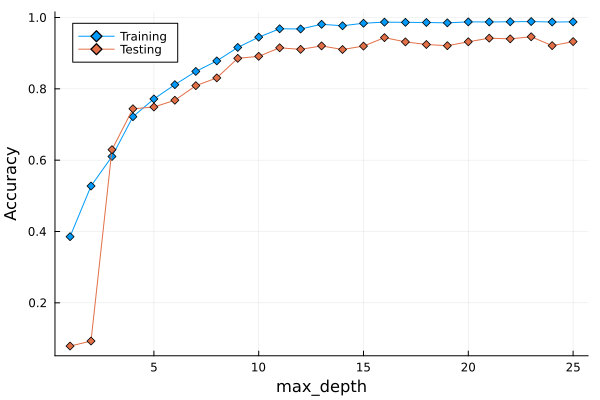

In [62]:
train=[]
test=[]
for i in 1:25
    rf = RandomForestClassifier(max_depth=i)
    mach_rf = machine(rf, X1, y)
    MLJ.fit!(mach_rf, rows=tr_inds)
    tr_acc = accuracy(MLJ.predict_mode(mach_rf, rows=tr_inds), y[tr_inds])
    te_acc = accuracy(MLJ.predict_mode(mach_rf, rows=te_inds), y[te_inds])
    push!(train, tr_acc)
    push!(test, te_acc)
end

plot(1:25,train,xlab="max_depth",ylab="Accuracy", marker=:d, label="Training", legend=:topleft)
plot!(1:25,test,xlab="max_depth",ylab="Accuracy", marker=:d, label="Testing")

Plot accuracy run chart with sub features from 1 to 20

┌ Info: Training machine(RandomForestClassifier(max_depth = 20, …), …).
└ @ MLJBase C:\Users\carlo\.julia\packages\MLJBase\CtxrQ\src\machines.jl:496


┌ Info: Training machine(RandomForestClassifier(max_depth = 20, …), …).
└ @ MLJBase C:\Users\carlo\.julia\packages\MLJBase\CtxrQ\src\machines.jl:496


┌ Info: Training machine(RandomForestClassifier(max_depth = 20, …), …).
└ @ MLJBase C:\Users\carlo\.julia\packages\MLJBase\CtxrQ\src\machines.jl:496


┌ Info: Training machine(RandomForestClassifier(max_depth = 20, …), …).
└ @ MLJBase C:\Users\carlo\.julia\packages\MLJBase\CtxrQ\src\machines.jl:496


┌ Info: Training machine(RandomForestClassifier(max_depth = 20, …), …).
└ @ MLJBase C:\Users\carlo\.julia\packages\MLJBase\CtxrQ\src\machines.jl:496


┌ Info: Training machine(RandomForestClassifier(max_depth = 20, …), …).
└ @ MLJBase C:\Users\carlo\.julia\packages\MLJBase\CtxrQ\src\machines.jl:496


┌ Info: Training machine(RandomForestClassifier(max_depth = 20, …), …).
└ @ MLJBase C:\Users\carlo\.julia\packages\MLJBase\CtxrQ\src\machines.jl:496


┌ Info: Training machine(RandomForestClassifier(max_depth = 20, …), …).
└ @ MLJBase C:\Users\carlo\.julia\packages\MLJBase\CtxrQ\src\machines.jl:496


┌ Info: Training machine(RandomForestClassifier(max_depth = 20, …), …).
└ @ MLJBase C:\Users\carlo\.julia\packages\MLJBase\CtxrQ\src\machines.jl:496


┌ Info: Training machine(RandomForestClassifier(max_depth = 20, …), …).
└ @ MLJBase C:\Users\carlo\.julia\packages\MLJBase\CtxrQ\src\machines.jl:496


┌ Info: Training machine(RandomForestClassifier(max_depth = 20, …), …).
└ @ MLJBase C:\Users\carlo\.julia\packages\MLJBase\CtxrQ\src\machines.jl:496


┌ Info: Training machine(RandomForestClassifier(max_depth = 20, …), …).
└ @ MLJBase C:\Users\carlo\.julia\packages\MLJBase\CtxrQ\src\machines.jl:496


┌ Info: Training machine(RandomForestClassifier(max_depth = 20, …), …).
└ @ MLJBase C:\Users\carlo\.julia\packages\MLJBase\CtxrQ\src\machines.jl:496


┌ Info: Training machine(RandomForestClassifier(max_depth = 20, …), …).
└ @ MLJBase C:\Users\carlo\.julia\packages\MLJBase\CtxrQ\src\machines.jl:496


┌ Info: Training machine(RandomForestClassifier(max_depth = 20, …), …).
└ @ MLJBase C:\Users\carlo\.julia\packages\MLJBase\CtxrQ\src\machines.jl:496


┌ Info: Training machine(RandomForestClassifier(max_depth = 20, …), …).
└ @ MLJBase C:\Users\carlo\.julia\packages\MLJBase\CtxrQ\src\machines.jl:496


┌ Info: Training machine(RandomForestClassifier(max_depth = 20, …), …).
└ @ MLJBase C:\Users\carlo\.julia\packages\MLJBase\CtxrQ\src\machines.jl:496


┌ Info: Training machine(RandomForestClassifier(max_depth = 20, …), …).
└ @ MLJBase C:\Users\carlo\.julia\packages\MLJBase\CtxrQ\src\machines.jl:496


┌ Info: Training machine(RandomForestClassifier(max_depth = 20, …), …).
└ @ MLJBase C:\Users\carlo\.julia\packages\MLJBase\CtxrQ\src\machines.jl:496


┌ Info: Training machine(RandomForestClassifier(max_depth = 20, …), …).
└ @ MLJBase C:\Users\carlo\.julia\packages\MLJBase\CtxrQ\src\machines.jl:496


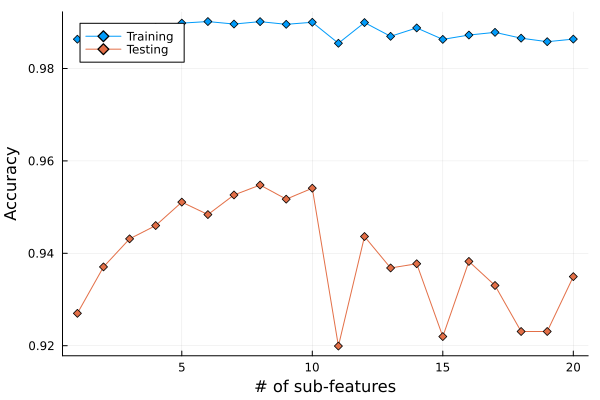

In [63]:
train=[]
test=[]
for i in 1:20
    rf = RandomForestClassifier(max_depth=20, n_subfeatures=i)
    mach_rf = machine(rf, X1, y)
    MLJ.fit!(mach_rf, rows=tr_inds)
    tr_acc = accuracy(MLJ.predict_mode(mach_rf, rows=tr_inds), y[tr_inds])
    te_acc = accuracy(MLJ.predict_mode(mach_rf, rows=te_inds), y[te_inds])
    push!(train, tr_acc)
    push!(test, te_acc)
end

plot(1:20,train,xlab="# of sub-features",ylab="Accuracy", marker=:d, label="Training", legend=:topleft)
plot!(1:20,test,xlab="# of sub-features",ylab="Accuracy", marker=:d, label="Testing")

Plot accuracy run chart with increasing number of trees

┌ Info: Training machine(RandomForestClassifier(max_depth = 20, …), …).
└ @ MLJBase C:\Users\carlo\.julia\packages\MLJBase\CtxrQ\src\machines.jl:496


┌ Info: Training machine(RandomForestClassifier(max_depth = 20, …), …).
└ @ MLJBase C:\Users\carlo\.julia\packages\MLJBase\CtxrQ\src\machines.jl:496


┌ Info: Training machine(RandomForestClassifier(max_depth = 20, …), …).
└ @ MLJBase C:\Users\carlo\.julia\packages\MLJBase\CtxrQ\src\machines.jl:496


┌ Info: Training machine(RandomForestClassifier(max_depth = 20, …), …).
└ @ MLJBase C:\Users\carlo\.julia\packages\MLJBase\CtxrQ\src\machines.jl:496


┌ Info: Training machine(RandomForestClassifier(max_depth = 20, …), …).
└ @ MLJBase C:\Users\carlo\.julia\packages\MLJBase\CtxrQ\src\machines.jl:496


┌ Info: Training machine(RandomForestClassifier(max_depth = 20, …), …).
└ @ MLJBase C:\Users\carlo\.julia\packages\MLJBase\CtxrQ\src\machines.jl:496


┌ Info: Training machine(RandomForestClassifier(max_depth = 20, …), …).
└ @ MLJBase C:\Users\carlo\.julia\packages\MLJBase\CtxrQ\src\machines.jl:496


┌ Info: Training machine(RandomForestClassifier(max_depth = 20, …), …).
└ @ MLJBase C:\Users\carlo\.julia\packages\MLJBase\CtxrQ\src\machines.jl:496


┌ Info: Training machine(RandomForestClassifier(max_depth = 20, …), …).
└ @ MLJBase C:\Users\carlo\.julia\packages\MLJBase\CtxrQ\src\machines.jl:496


┌ Info: Training machine(RandomForestClassifier(max_depth = 20, …), …).
└ @ MLJBase C:\Users\carlo\.julia\packages\MLJBase\CtxrQ\src\machines.jl:496


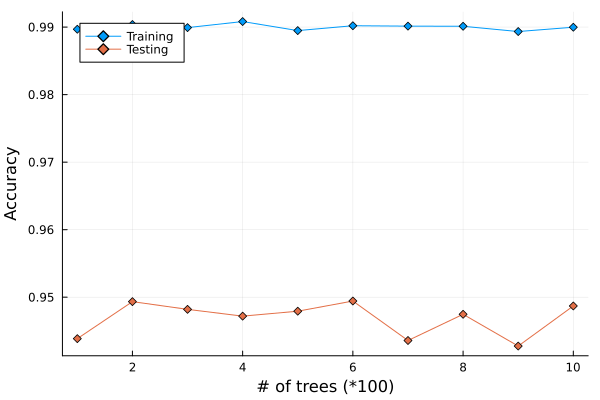

In [64]:
train=[]
test=[]
for i=100:100:1000
    rf = RandomForestClassifier(max_depth=20, n_subfeatures=8, n_trees=i)
    mach_rf = machine(rf, X1, y)
    MLJ.fit!(mach_rf, rows=tr_inds)
    tr_acc = accuracy(MLJ.predict_mode(mach_rf, rows=tr_inds), y[tr_inds])
    te_acc = accuracy(MLJ.predict_mode(mach_rf, rows=te_inds), y[te_inds])
    push!(train, tr_acc)
    push!(test, te_acc)
end

plot(1:10,train,xlab="# of trees (*100)",ylab="Accuracy", marker=:d, label="Training", legend=:topleft)
plot!(1:10,test,xlab="# of trees (*100)",ylab="Accuracy", marker=:d, label="Testing")

Re-run model with best max depth, sub-features and number of trees

In [65]:
rf = RandomForestClassifier(max_depth=20, n_subfeatures=8, n_trees=100)
mach_rf = machine(rf, X1, y)
eval_rf=evaluate!(mach_rf, rows=tr_inds,resampling=CV(nfolds=10,shuffle=true,rng=42), measure=accuracy,operation=predict_mode)

┌ Info: Creating subsamples from a subset of all rows. 
└ @ MLJBase C:\Users\carlo\.julia\packages\MLJBase\CtxrQ\src\resampling.jl:601


Evaluating over 10 folds:  20%[=====>                   ]  ETA: 0:03:18

Evaluating over 10 folds:  30%[=======>                 ]  ETA: 0:02:54

Evaluating over 10 folds:  40%[==========>              ]  ETA: 0:02:28

Evaluating over 10 folds:  50%[============>            ]  ETA: 0:02:03

Evaluating over 10 folds:  60%[===============>         ]  ETA: 0:01:37

Evaluating over 10 folds:  70%[=================>       ]  ETA: 0:01:13

Evaluating over 10 folds:  80%[====================>    ]  ETA: 0:00:49

Evaluating over 10 folds:  90%[======================>  ]  ETA: 0:00:24

Evaluating over 10 folds: 100%[=========================] Time: 0:04:04


PerformanceEvaluation object with these fields:
  measure, operation, measurement, per_fold,
  per_observation, fitted_params_per_fold,
  report_per_fold, train_test_rows
Extract:
┌────────────┬──────────────┬─────────────┬─────────┬───────────────────────────
│ measure    │ operation    │ measurement │ 1.96*SE │ per_fold                 ⋯
├────────────┼──────────────┼─────────────┼─────────┼───────────────────────────
│ Accuracy() │ predict_mode │ 0.976       │ 0.00193 │ [0.975, 0.977, 0.975, 0. ⋯
└────────────┴──────────────┴─────────────┴─────────┴───────────────────────────
                                                                1 column omitted


In [66]:
yhat = predict_mode(mach_rf, rows=te_inds)
test_results["acc_rf"] = accuracy(yhat, y[te_inds])

0.9423533710944637

Accuracy has improved... let's check the Confusion Matrix

In [67]:
ConfusionMatrix()(yhat, y[te_inds])

┌ Warning: The classes are un-ordered,
│ using order: [0.0, 1.0, 2.0, 3.0, 4.0].
│ To suppress this warning, consider coercing to OrderedFactor.
└ @ MLJBase C:\Users\carlo\.julia\packages\MLJBase\CtxrQ\src\measures\confusion_matrix.jl:122


5×5 Matrix{Int64}:
 17178  105    74   18    45
   408  438     9    1     2
   291    7  1336   13    13
   141    3    22  130     0
   100    3     7    0  1548

We can also look into automatic tuning to see what the best settings are for the RF model. Below, we only limited the auto-tuning to two hyperparameters (max_depth and n_subfeatures). We tried using four hyperparameters, but unfortunately adding anything more than two significantly increases the time it takes to train the model. We definitely recommend exploring the other hyperparameters as well, but for the purposes of our report, we will only look at two hyperparameters below. 

In [32]:
Random.seed!(1234)
r1 = range(rf, :n_subfeatures, lower=1, upper=20)
r2 = range(rf, :max_depth, lower=1, upper=20)
# r3 = range(rf, :sampling_fraction, lower=0.4, upper=1.0)
# r4 = range(rf, :n_trees, lower=10, upper=200)
tm = TunedModel(model=rf, tuning=Grid(resolution=10),
                resampling=CV(nfolds=10), ranges=[r1, r2],
                measure=accuracy)

ProbabilisticTunedModel(
  model = RandomForestClassifier(
        max_depth = -1, 
        min_samples_leaf = 1, 
        min_samples_split = 2, 
        min_purity_increase = 0.0, 
        n_subfeatures = -1, 
        n_trees = 10, 
        sampling_fraction = 0.7, 
        feature_importance = :impurity, 
        rng = Random._GLOBAL_RNG()), 
  tuning = Grid(
        goal = nothing, 
        resolution = 10, 
        shuffle = true, 
        rng = Random._GLOBAL_RNG()), 
  resampling = CV(
        nfolds = 10, 
        shuffle = false, 
        rng = Random._GLOBAL_RNG()), 
  measure = Accuracy(), 
  weights = nothing, 
  class_weights = nothing, 
  operation = nothing, 
  range = MLJBase.NumericRange{Int64, MLJBase.Bounded, Symbol}[NumericRange(1 ≤ n_subfeatures ≤ 20; origin=10.5, unit=9.5), NumericRange(1 ≤ max_depth ≤ 20; origin=10.5, unit=9.5)], 
  selection_heuristic = MLJTuning.NaiveSelection(nothing), 
  train_best = true, 
  repeats = 1, 
  n = nothing, 
  acceleration = CPU

In [33]:
self_tuning_rf = machine(tm, X1, y)
MLJ.fit!(self_tuning_rf, verbosity=0)

trained Machine; does not cache data
  model: ProbabilisticTunedModel(model = RandomForestClassifier(max_depth = -1, …), …)
  args: 
    1:	Source @037 ⏎ Table{AbstractVector{Continuous}}
    2:	Source @555 ⏎ AbstractVector{Multiclass{5}}


In [34]:
fitted_params(self_tuning_rf).best_model

RandomForestClassifier(
  max_depth = 20, 
  min_samples_leaf = 1, 
  min_samples_split = 2, 
  min_purity_increase = 0.0, 
  n_subfeatures = 9, 
  n_trees = 10, 
  sampling_fraction = 0.7, 
  feature_importance = :impurity, 
  rng = Random._GLOBAL_RNG())

We can evaluate our model again using the best settings noted above to see if it improves accuracy.

In [35]:
rf = RandomForestClassifier(max_depth=20, n_subfeatures=9, n_trees=10)
mach_rf = machine(rf, X1, y)
eval_rf=evaluate!(mach_rf, rows=tr_inds,resampling=CV(nfolds=10,shuffle=true,rng=42), measure=accuracy,operation=predict_mode)

┌ Info: Creating subsamples from a subset of all rows. 
└ @ MLJBase C:\Users\carlo\.julia\packages\MLJBase\CtxrQ\src\resampling.jl:601


Evaluating over 10 folds:  20%[=====>                   ]  ETA: 0:00:21

Evaluating over 10 folds:  30%[=======>                 ]  ETA: 0:00:17

Evaluating over 10 folds:  40%[==========>              ]  ETA: 0:00:15

Evaluating over 10 folds:  50%[============>            ]  ETA: 0:00:13

Evaluating over 10 folds:  60%[===============>         ]  ETA: 0:00:10

Evaluating over 10 folds:  70%[=================>       ]  ETA: 0:00:08

Evaluating over 10 folds:  80%[====================>    ]  ETA: 0:00:05

Evaluating over 10 folds:  90%[======================>  ]  ETA: 0:00:03

Evaluating over 10 folds: 100%[=========================] Time: 0:00:26


PerformanceEvaluation object with these fields:
  measure, operation, measurement, per_fold,
  per_observation, fitted_params_per_fold,
  report_per_fold, train_test_rows
Extract:
┌────────────┬──────────────┬─────────────┬─────────┬───────────────────────────
│ measure    │ operation    │ measurement │ 1.96*SE │ per_fold                 ⋯
├────────────┼──────────────┼─────────────┼─────────┼───────────────────────────
│ Accuracy() │ predict_mode │ 0.978       │ 0.00183 │ [0.983, 0.979, 0.977, 0. ⋯
└────────────┴──────────────┴─────────────┴─────────┴───────────────────────────
                                                                1 column omitted


In [37]:
yhat = predict_mode(mach_rf, rows=te_inds)
accuracy(yhat, y[te_inds])

0.9456422437420062

In [38]:
ConfusionMatrix()(yhat, y[te_inds])

┌ Warning: The classes are un-ordered,
│ using order: [0.0, 1.0, 2.0, 3.0, 4.0].
│ To suppress this warning, consider coercing to OrderedFactor.
└ @ MLJBase C:\Users\carlo\.julia\packages\MLJBase\CtxrQ\src\measures\confusion_matrix.jl:122


5×5 Matrix{Int64}:
 17276  122    71   19    44
   375  423    18    3     3
   275    7  1328   10    15
   115    2    23  130     1
    77    2     8    0  1545

Slight improvement, but nothing too drastic, which is expected since the settings are very similar to the ones we selected based on the manual tuning that we've done. 

### Linear Discriminant Analysis (LDA)

Wrap parameters in a model and create a machine using the model and data.

In [68]:
Random.seed!(1234);
model_lda=@load LDA
lda = model_lda()
mach_lda=machine(lda, X, y)

import MLJMultivariateStatsInterface

┌ Info: For silent loading, specify `verbosity=0`. 
└ @ Main C:\Users\carlo\.julia\packages\MLJModels\GlOTy\src\loading.jl:159


 ✔


untrained Machine; caches model-specific representations of data
  model: LDA(method = gevd, …)
  args: 
    1:	Source @359 ⏎ Table{AbstractVector{Continuous}}
    2:	Source @894 ⏎ AbstractVector{Multiclass{5}}


Evaluate the model using a 10-fold cross-validation.

In [69]:
eval_lda = evaluate!(mach_lda, rows=tr_inds, resampling=CV(nfolds=10,shuffle=true,rng=42), measure=accuracy,operation=predict_mode)

┌ Info: Creating subsamples from a subset of all rows. 
└ @ MLJBase C:\Users\carlo\.julia\packages\MLJBase\CtxrQ\src\resampling.jl:601
Evaluating over 10 folds:  20%[=====>                   ]  ETA: 0:00:17

Evaluating over 10 folds:  30%[=======>                 ]  ETA: 0:00:10

Evaluating over 10 folds:  40%[==========>              ]  ETA: 0:00:07

Evaluating over 10 folds:  50%[============>            ]  ETA: 0:00:05

Evaluating over 10 folds:  60%[===============>         ]  ETA: 0:00:03

Evaluating over 10 folds:  70%[=================>       ]  ETA: 0:00:02

Evaluating over 10 folds:  80%[====================>    ]  ETA: 0:00:01

Evaluating over 10 folds:  90%[======================>  ]  ETA: 0:00:01

Evaluating over 10 folds: 100%[=========================] Time: 0:00:05


PerformanceEvaluation object with these fields:
  measure, operation, measurement, per_fold,
  per_observation, fitted_params_per_fold,
  report_per_fold, train_test_rows
Extract:
┌────────────┬──────────────┬─────────────┬─────────┬───────────────────────────
│ measure    │ operation    │ measurement │ 1.96*SE │ per_fold                 ⋯
├────────────┼──────────────┼─────────────┼─────────┼───────────────────────────
│ Accuracy() │ predict_mode │ 0.766       │ 0.00471 │ [0.765, 0.773, 0.767, 0. ⋯
└────────────┴──────────────┴─────────────┴─────────┴───────────────────────────
                                                                1 column omitted


Use the trained model to predict the test data and measure the accuracy. 

In [70]:
yhat = predict_mode(mach_lda, rows=te_inds)
test_results["acc_lda"] = accuracy(yhat, y[te_inds])

0.6918052256532066

The accuracy rating is much lower compared to all the other models we explored. 

Collect all the accuracy calculated in the cross-validation and create a visualization presenting the average and standard deviations of the 10 results for each model

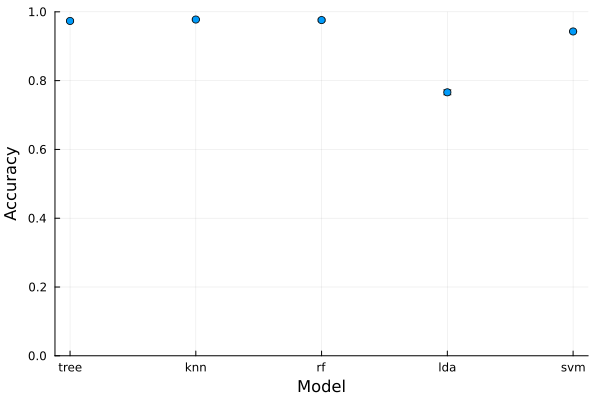

In [71]:
results= [eval_tree.measurement[1], eval_knn.measurement[1],eval_rf.measurement[1],eval_lda.measurement[1],eval_svm.measurement[1]];
errors=[std(eval_tree.per_fold[1]),std(eval_knn.per_fold[1]),std(eval_rf.per_fold[1]),std(eval_lda.per_fold[1]),std(eval_svm.per_fold[1])]
scatter(["tree", "knn", "rf", "lda", "svm"],results,yerror=errors,ylims=[0,1],label=nothing, xlab="Model", ylab="Accuracy")

Check accuracy of the test set

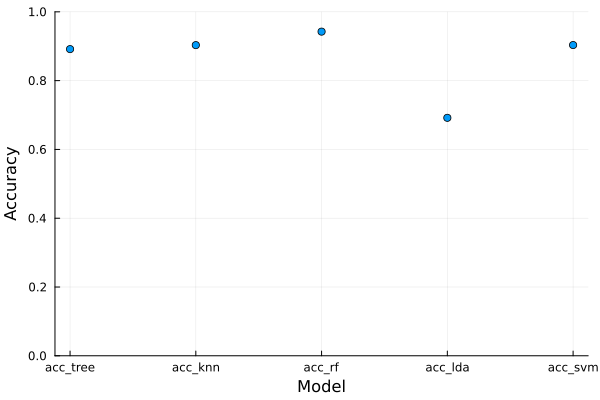

In [72]:
scatter(Array(string.(keys(test_results))),Array(float.(values(test_results))),ylims=[0,1],label=nothing, xlab="Model", ylab="Accuracy")